# COLOR DETECTION STUDY

In [1]:
import sys
sys.path.append('/Users/daniel/OAN/SID/')
import pandas

from dotenv import load_dotenv
 
load_dotenv(dotenv_path='/Users/daniel/OAN/SID/.env')

True

In [2]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import sqlite3
import re
import time
import random
import os

In [3]:
import seaborn as sns

In [4]:
from scipy import ndimage
from tqdm import tqdm

In [328]:
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

In [5]:
def display(img,cmap=None):
    if cmap == 'gray':
        im=img
    else:
        im = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    fig = plt.figure(figsize=(10,8))
    ax = fig.add_subplot(111)
    ax.imshow(im,cmap=cmap)

### Open Image

In [6]:
train_path = '/Users/daniel/OAN/SID/dataset/train/'

In [7]:
images_routes = [im_route 
          for im_route in os.listdir(train_path)
          if 'jpg' in im_route]

In [9]:
vill = random.choice(images_routes)
vill

'1ERUqn0IWwczeIWYqkTJhv61XOVB5IExf_8_png.rf.043e5782cf9b4075e87892f38489a483.jpg'

In [10]:
vills = [vil for vil in images_routes if vil.split('.')[0] == '1JhDdg8O_fosVOdn6szTA3mMPmg10InAp_2_png']
print(vill)

1ERUqn0IWwczeIWYqkTJhv61XOVB5IExf_8_png.rf.043e5782cf9b4075e87892f38489a483.jpg


In [281]:
vill = vills[0]

In [282]:
image = cv2.imread(train_path+vill)

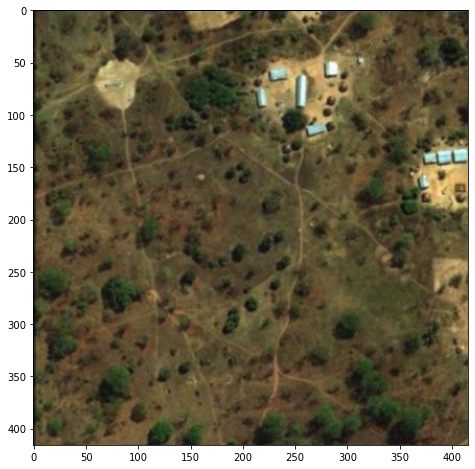

In [283]:
display(image)

### READ ANNOTATIONS

In [14]:
df_anot = pd.read_csv(train_path+'_annotations.csv',header=None)

In [15]:
df_anot.columns = ['im_path','l','t','r','b','type']

In [16]:
df_anot[df_anot['im_path']==vill].head()

,im_path,l,t,r,b,type
2135,1JhDdg8O_fosVOdn6szTA3mMPmg10InAp_2_png.rf.091...,213,75,223,93,buildings
2136,1JhDdg8O_fosVOdn6szTA3mMPmg10InAp_2_png.rf.091...,226,56,242,67,buildings
2137,1JhDdg8O_fosVOdn6szTA3mMPmg10InAp_2_png.rf.091...,251,63,262,93,buildings
2138,1JhDdg8O_fosVOdn6szTA3mMPmg10InAp_2_png.rf.091...,260,107,278,121,buildings
2139,1JhDdg8O_fosVOdn6szTA3mMPmg10InAp_2_png.rf.091...,280,48,290,64,buildings


In [17]:
df_anot['house'] =df_anot.apply(lambda x:
                                  [
                                      [x['l'],x['t']],
                                      [x['l'],x['b']],
                                      [x['r'],x['b']],
                                      [x['r'],x['t']]
                                  ]
                                 ,axis=1)

In [18]:
v = image.copy()
g_cont = []
houses_im = df_anot[df_anot['im_path']==vill]['house'].to_list()
for c in houses_im:
    pts = np.array(c)
    a=cv2.polylines(v,[pts],isClosed=True,color=(0,0,255),thickness=1)
    g_cont.append(c)

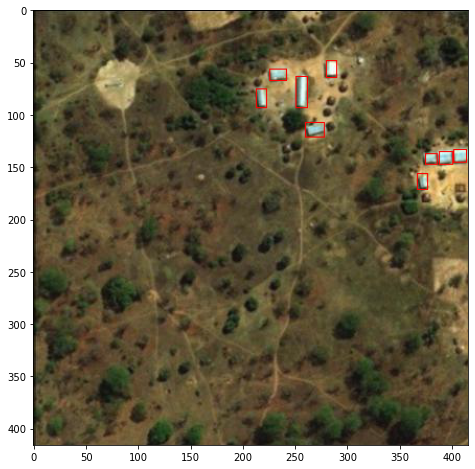

In [19]:
display(v)

### GET COLOR OF HOUSE PIXELS

In [285]:
df_all_ho = df_anot[df_anot['im_path']==vill]

image = cv2.imread(train_path+vill)
bg = image.copy().astype(np.uint16)

bg = 2+bg

h = df_all_ho["house"].iloc[0]

pts = np.array(list(h))

mask = 255*np.ones(image.shape[:2], np.uint8)
cv2.drawContours(mask, [pts], -1, (0, 0, 0), -1, cv2.LINE_AA)
bg = cv2.bitwise_and(bg, bg, mask=mask)

In [287]:
image = cv2.imread(train_path+vill)
#hsl = cv2.cvtColor(image, cv2.COLOR_BGR2HLS)

pts = np.array(h)

In [288]:
#SINCE PTS ARE ALWAYS BOUNDING BOX JUST NEED TO CROP IMAGE

## (1) Crop the bounding rect
rect = cv2.boundingRect(pts)
x,y,w,h = rect
croped = image[y:y+h, x:x+w].copy()
house_pixels = croped.reshape(croped.shape[0]*croped.shape[1],croped.shape[2])
house_pixels_nw = [pix for pix in house_pixels if (pix != [255,255,255]).all()]

(unique_house, counts_house) = np.unique(house_pixels_nw, return_counts=True,axis=0)


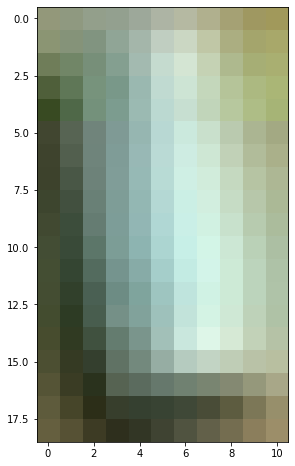

In [289]:
display(croped)

In [290]:
df_image = pd.DataFrame(unique, counts,columns=['r','g','b'])

<AxesSubplot:>

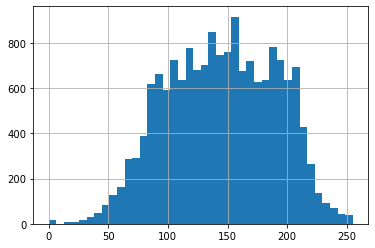

In [291]:
df_image['r'].hist(bins=40)

<AxesSubplot:>

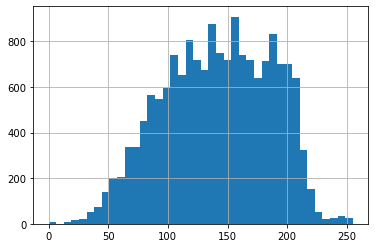

In [292]:
df_image['g'].hist(bins=40)

<AxesSubplot:>

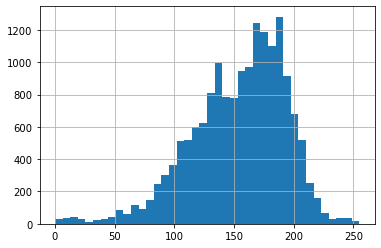

In [293]:
df_image['b'].hist(bins=40)

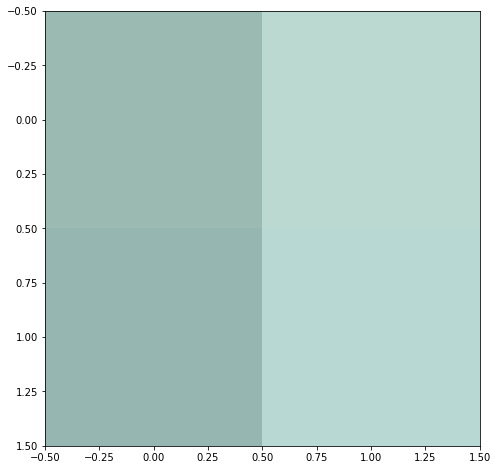

In [297]:
display(croped[4:6,4:6,:])

In [298]:
croped[4:6,4:6,:]

array([[[178, 186, 155],
        [209, 217, 187]],

       [[177, 182, 150],
        [211, 216, 184]]], dtype=uint8)

In [ ]:
## BACKGROUD

In [299]:
df_all_ho = df_anot[df_anot['im_path']==vill]

image = cv2.imread(train_path+vill)
bg = image.copy().astype(np.uint16)

bg = 2+bg

for h in df_all_ho["house"]:

    pts = np.array(list(h))

    mask = 255*np.ones(image.shape[:2], np.uint8)
    cv2.drawContours(mask, [pts], -1, (0, 0, 0), -1, cv2.LINE_AA)
    bg = cv2.bitwise_and(bg, bg, mask=mask)


In [300]:
bg_dis = bg.copy()

In [301]:
bg_dis[(bg_dis==(0,0,0)).all(axis=2)] = (2,2,2)

In [302]:
bg_dis.max()

257

In [303]:
bg_dis.min()

2

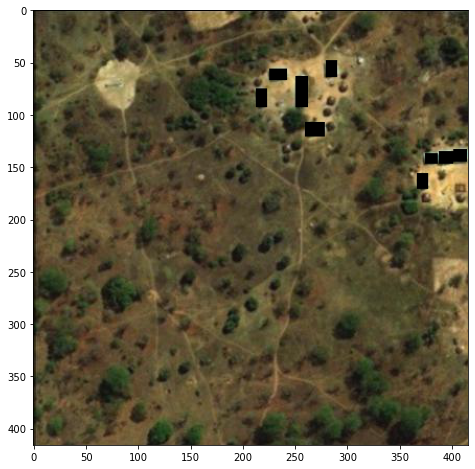

In [304]:
display(bg_dis-2)

### HOUSES

In [305]:
hous = bg.copy()

In [306]:
mask = bg.copy()
mask[np.logical_not((bg==(0,0,0)).all(axis=2))] = (2,2,2)
mask[(bg==(0,0,0)).all(axis=2)] = (257,257,257)

In [312]:
mask.shape

(416, 416, 3)

In [313]:
mask.max()

257

In [314]:
mask.min()

2

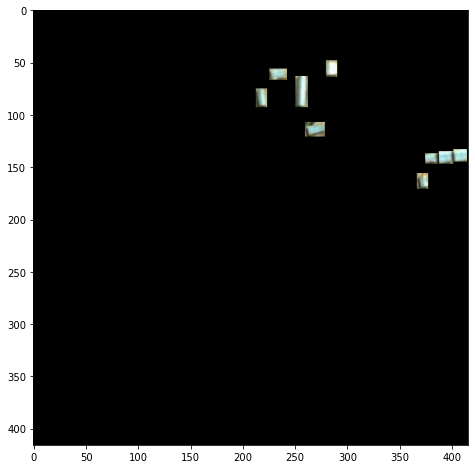

In [315]:
im_houses = np.where(mask==(257,257,257),image,(0,0,0)).astype(np.uint8)
display(im_houses)

In [316]:
im_houses = np.where(mask==(257,257,257),image+2,(0,0,0)).astype(np.uint8)

In [317]:
house_pixels = im_houses.reshape(im_houses.shape[0]*im_houses.shape[1],im_houses.shape[2])
house_pixels_non_mask = [pix-2 for pix in house_pixels if (pix != [0,0,0]).all()]
    
bg_pixels = bg.reshape(bg.shape[0]*bg.shape[1],bg.shape[2])
bg_pixels_non_mask = [pix-2 for pix in bg_pixels if (pix != [0,0,0]).all()]

In [318]:
df_house = pd.DataFrame({'pixel':house_pixels_non_mask})
df_house['type'] = 'house'
df_bg = pd.DataFrame({'pixel':bg_pixels_non_mask})
df_bg['type'] = 'background'

In [319]:
df_image = df_house.append(df_bg)

In [320]:
df_image.head()

,pixel,type
0,"[97, 137, 135]",house
1,"[108, 147, 139]",house
2,"[103, 140, 130]",house
3,"[121, 158, 150]",house
4,"[132, 166, 165]",house


In [354]:
df_image[['b','g','r']] = df_image['pixel'].apply(lambda x: pd.Series(x))

Text(0.5, 1.0, 'Azules y rojos de los pixels de casas y fondo')

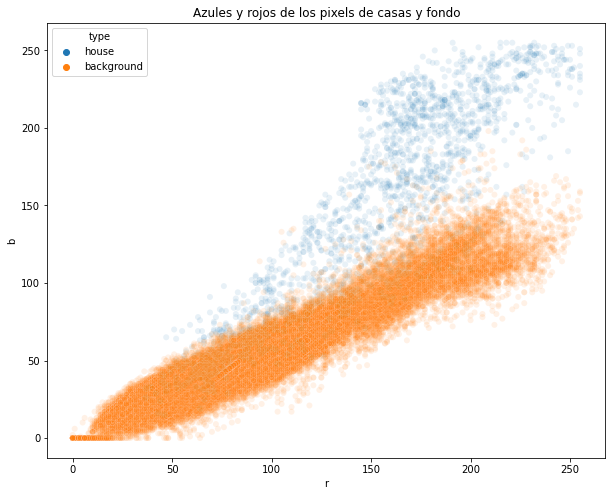

In [359]:
plt.figure(figsize = (10,8))
sns.scatterplot(x='r',y='b',alpha=0.1,data= df_image,hue='type')
plt.title('Azules y rojos de los pixels de casas y fondo')

Text(0.5, 1.0, 'Verdes y rojos de los pixels de casas y fondo')

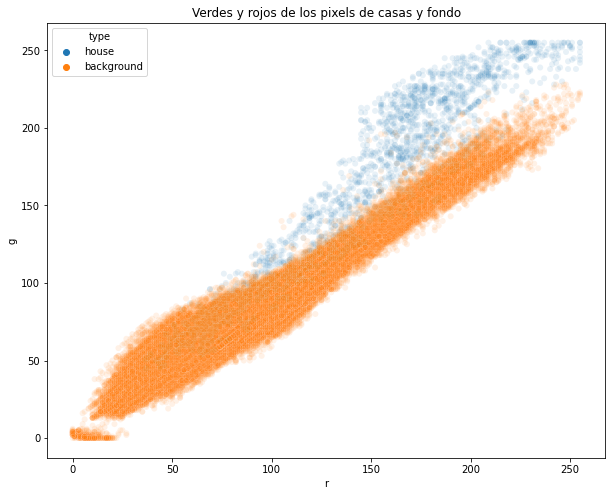

In [360]:
plt.figure(figsize = (10,8))
sns.scatterplot(x='r',y='g',alpha=0.1,data= df_image,hue='type')
plt.title('Verdes y rojos de los pixels de casas y fondo')

Text(0.5, 1.0, 'Azules y verdes de los pixels de casas y fondo')

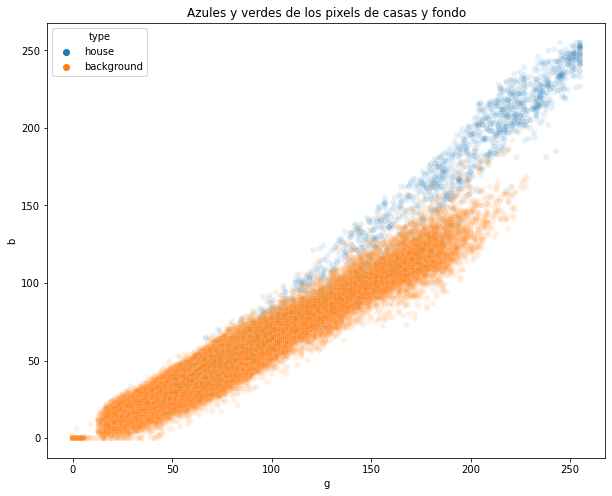

In [361]:
plt.figure(figsize = (10,8))
sns.scatterplot(x='g',y='b',alpha=0.1,data= df_image,hue='type')
plt.title('Azules y verdes de los pixels de casas y fondo')

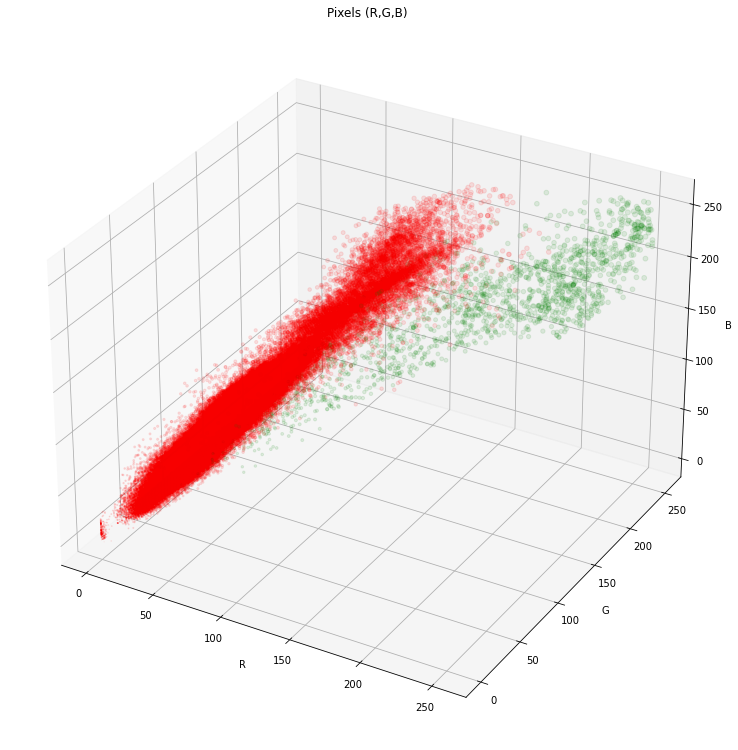

In [336]:
X = df_image['r']
Y = df_image['g']
Z = df_image['b']
fig = plt.figure(figsize=(20,10))
ax = Axes3D(fig)
sc = ax.scatter3D(X, Y, Z, s= (X+Y+Z)/30,alpha=0.1, c=df_image['type'].apply(lambda x: x.replace('house','green'
                                                                                  ).replace('background','red')))

ax.set_xlabel('R')
ax.set_ylabel('G')
ax.set_zlabel('B')

plt.title('Pixels (R,G,B)')

#X = np.arange(0, 255, 2)
#Y = np.arange(0, 255, 2)
#X, Y = np.meshgrid(X, Y)
#Z = 150 *np.ones(shape=(1,len(X)))
#
#surf = ax.plot_surface(X, Y, Z, rstride=1, cstride=1,alpha=0.3,linewidth=0)


plt.show()

In [338]:
import plotly.express as px

In [348]:
fig = px.scatter_3d(df_image, x='r', y='g', z='b',opacity=0.1,title='pixel_distribution',
                    color='type')
fig.show()

In [ ]:
for vill in df_anot['im_path'].unique():

    df_all_ho = df_anot[df_anot['im_path']==vill]

    image = cv2.imread(train_path+vill)
    bg = image.copy().astype(np.uint16)

    bg = 2+bg

    for h in df_all_ho["house"]:

        pts = np.array(list(h))

        mask = 255*np.ones(image.shape[:2], np.uint8)
        cv2.drawContours(mask, [pts], -1, (0, 0, 0), -1, cv2.LINE_AA)
        bg = cv2.bitwise_and(bg, bg, mask=mask)
    
    mask = bg.copy()
    mask[np.logical_not((bg==(0,0,0)).all(axis=2))] = (2,2,2)
    mask[(bg==(0,0,0)).all(axis=2)] = (257,257,257)
    
    im_houses = np.where(mask==(257,257,257),image+2,(0,0,0)).astype(np.uint8)
    
    house_pixels = im_houses.reshape(im_houses.shape[0]*im_houses.shape[1],im_houses.shape[2])
    
    house_pixels_non_mask = [2+pix for pix in house_pixels if]
    
    (unique, counts) = np.unique(house_pixels, return_counts=True,axis=0)
    

### MAKE DETECTION

In [362]:
test_path = '/Users/daniel/OAN/SID/dataset/test/'

In [363]:
images_routes_test = [im_route 
          for im_route in os.listdir(test_path)
          if 'jpg' in im_route]

In [412]:
vill_test = random.choice(images_routes_test)
vill_test

'29_JPG.rf.aa9d30bd160d234ceade4bec09e2d91b.jpg'

In [413]:
image = cv2.imread(test_path+vill_test)

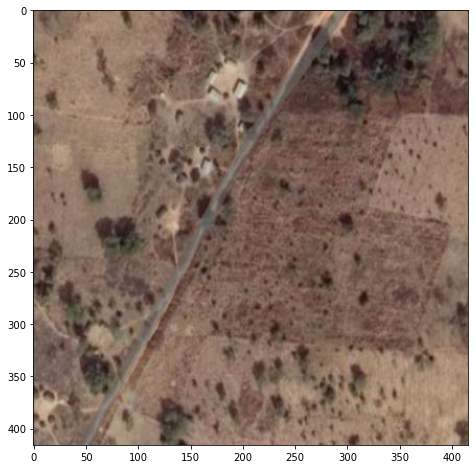

In [414]:
display(image)

### INTENSITY BASED

In [420]:
image = cv2.imread(train_path+vill)

In [421]:
b,g,r = 0.5,0.3,0.2

In [422]:
b,g,r = 0.5,0.3,0.2
image_i = (b*image[:,:,0]+g*image[:,:,0]+r*image[:,:,0])
image_i = 255 * image_i/image_i.max()
image_i = image_i.astype(np.uint8)

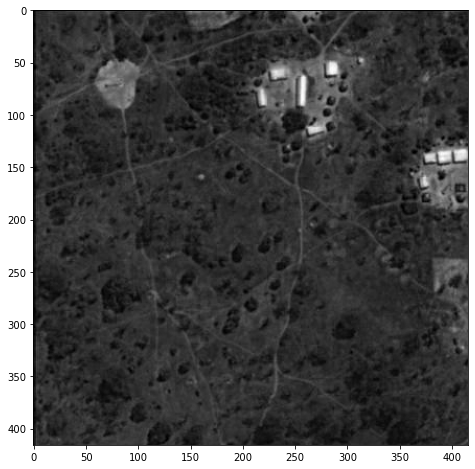

In [423]:
display(image_i)

In [435]:
image_i_pix = image_i.reshape(image_i.shape[0]*image_i.shape[1],1)

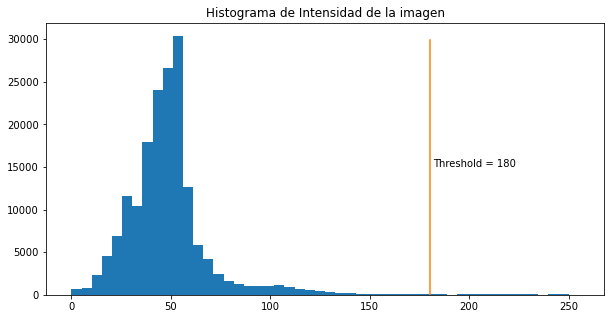

In [442]:
f = plt.figure(figsize=(10,5))
plt.hist(image_i_pix,bins=50)
plt.title('Histograma de Intensidad de la imagen')
y = np.arange(0,30000,100)
x = 180*np.ones(shape=(len(y),1))
plt.plot(x,y)

plt.text(182, 15000,'Threshold = 180')
plt.show()

In [430]:
th, im_bin = cv2.threshold(image_i,180,255,cv2.THRESH_BINARY)

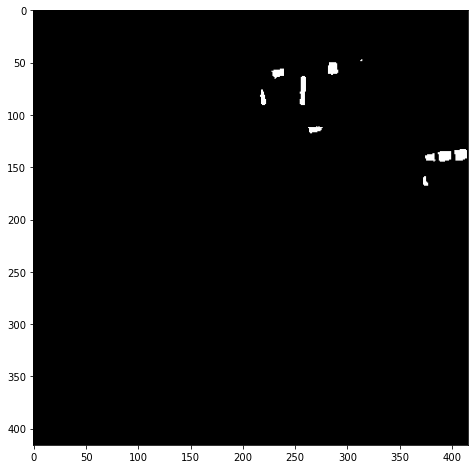

In [431]:
display(im_bin)

In [464]:
def jaccard(a, b):
    """box_X is a tuple of the shape (x1, y1, x2, y2)."""
    side1 = max(0, min(a[2], b[2]) - max(a[0], b[0]))
    side2 = max(0, min(a[3], b[3]) - max(a[1], b[1]))
    inter = side1 * side2
    
    area_a = (a[2] - a[0]) * (a[3] - a[1])
    area_b = (b[2] - b[0]) * (b[3] - b[1])
    union = area_a + area_b - inter
    
    return inter / union


def is_valid(box_pred, box_true, threshold=0.2):
    return jaccard(box_pred, box_true) >= threshold

In [465]:
def compute_metrics(true_pos, false_pos, false_neg):
    if (true_pos + false_neg) == 0 or false_pos+true_pos == 0:
        return 0, 0, 0
    """Compute the precision, recall, and f1 score."""
    precision = true_pos / (true_pos + false_pos)
    recall = true_pos / (true_pos + false_neg)

    if precision == 0 or recall == 0:
        return precision, recall, 0

    f1 = 2 / (1 / precision + 1 / recall)
    return precision, recall, f1

In [470]:
def detect_houses_int(image,vill,df_anot,verb=False):
    b,g,r = 0.5,0.3,0.2
    image_i = (b*image[:,:,0]+g*image[:,:,0]+r*image[:,:,0])
    image_i = 255 * image_i/image_i.max()
    image_i = image_i.astype(np.uint8)
    
    
    th, im_gay = cv2.threshold(image_i,180,255,cv2.THRESH_BINARY)
    
    if verb:
        display(im_gay)

    # apply morphology close
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))
    im_gay = cv2.morphologyEx(im_gay, cv2.MORPH_CLOSE, kernel)
    
    if verb:
        display(im_gay)
        
    # apply morphology open
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))
    im_gay = cv2.morphologyEx(im_gay, cv2.MORPH_OPEN, kernel)
        
    
    
    if verb:
        display(im_gay)

    # apply morphology erode
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3,3))
    #im_gay = cv2.morphologyEx(im_gay, cv2.MORPH_ERODE, kernel)
    
    #if verb:
        #display(im_gay)
    
    

    houses = []
    box_tp = []
    im_draw = image.copy()
    contours, hierarchy = cv2.findContours(im_gay.copy(), cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)
    
    
    df_houss = df_anot[df_anot['im_path'] == vill]

    # For every entry in contours
    for i,c in enumerate(contours):

        # last column in the array is -1 if an external contour (no contours inside of it)
        if hierarchy[0][i][3] == -1:

            if 10 < c.size and c.size < 200 : 
                #print(c.size)
                rect = cv2.minAreaRect(c)
                box = cv2.boxPoints(rect)
                box = np.int0(box)
                x, y = np.min(box,axis=0)
                x_max, y_max = np.max(box,axis=0)
                
                bbox = (x,y,x_max,y_max)
                w, h = x_max -x, y_max - y

                cx = x+w//2
                cy = y+h//2
                cr  = max(w,h)//2

                ## set offset, repeat enlarger ROI
                dr = 2
                dw = w//2+1*dr
                dh = h//2+1*dr
                
                bbox_2 = (cx-dw,cy-dh,cx+dw,cy+dh)
                ##EVALUATION
                bool_tp = df_houss['box'].apply(lambda x: is_valid(bbox_2,x)).any()
                if bool_tp:
                    box_tp.append(bbox_2)
                    cv2.rectangle(im_draw, (cx-dw, cy-dh), (cx+dw, cy+dh), (0,255,0), 1)
                else:
                    cv2.rectangle(im_draw, (cx-dw, cy-dh), (cx+dw, cy+dh), (0,0,255), 1)


                #cv2.drawContours(im_draw,[box],0,(0,0,255),2)
                # We can now draw the external contours from the list of contours
                #cv2.drawContours(im_draw, contours, i, (255, 0, 0), 1)

               #M = cv2.moments(c)
               #if 0 != M["m00"]:
               #    cX = int(M["m10"] / M["m00"])
               #    cY = int(M["m01"] / M["m00"])
               #    cv2.circle(im_draw, (cX, cY), 1, (0, 0, 255), -1)
               #    
                    
                        
                    
                    

                houses.append(bbox_2)
                
                
                    
                    
                
    #display(im_draw)
    
    return im_draw,houses,box_tp

In [467]:
df_anot['box'] = df_anot.apply(lambda x: (x['l'],x['t'],x['r'],x['b']),axis=1)

TP 9, FP 0 FN 0
precis = 100.0%, acc = 100.0%, f1 = 100.0%


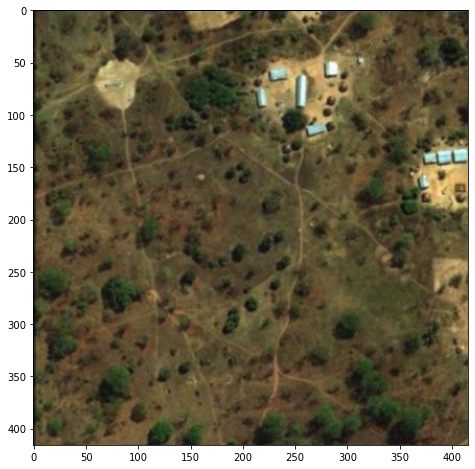

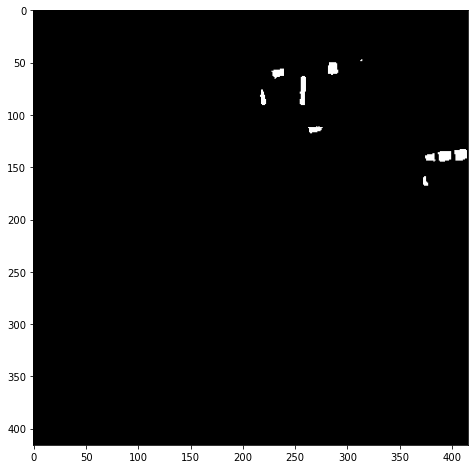

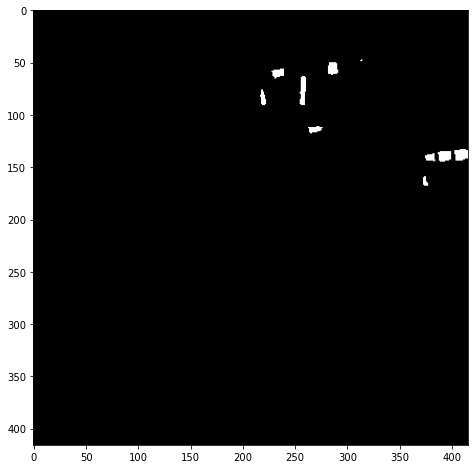

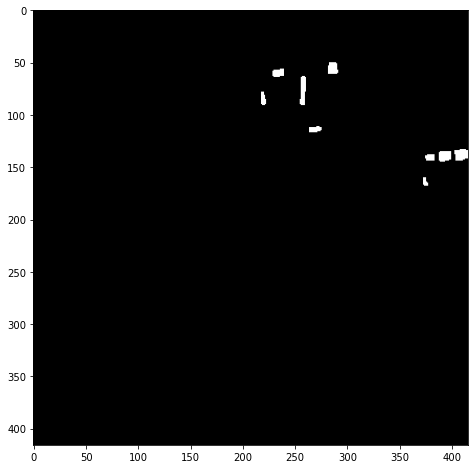

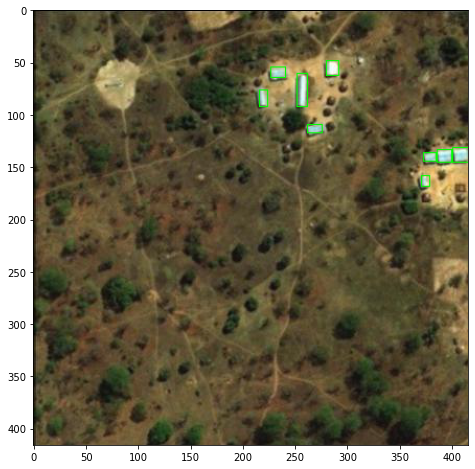

In [471]:
train=True
ss_im = True
if train:
    r_p = train_path
    df_an = df_anot
else:
    r_p = test_path
    df_an = df_anot_test
    
image_g_det = cv2.imread(r_p+vill)
display(image_g_det)
im_draw,boxes,box_tp = detect_houses_int(image_g_det,vill,df_an,ss_im)
display(im_draw)

df_houss = df_an[df_an['im_path'] == vill]


real_b = df_houss.shape[0]

true_pos = len(box_tp)
false_pos = len(boxes)-len(box_tp)
false_neg = real_b-len(box_tp)
pr, acc, f1 = compute_metrics(true_pos, false_pos, false_neg)


print('TP {}, FP {} FN {}'.format(true_pos,false_pos,false_neg))
print('precis = {}%, acc = {}%, f1 = {}%'.format(round(100*pr,2),round(acc*100,2),round(f1*100,2)))

Running inference on: 1JhDdg8O_fosVOdn6szTA3mMPmg10InAp_2_png.rf.091d43b26e849f0da04ff6ea9ff4150f.jpg


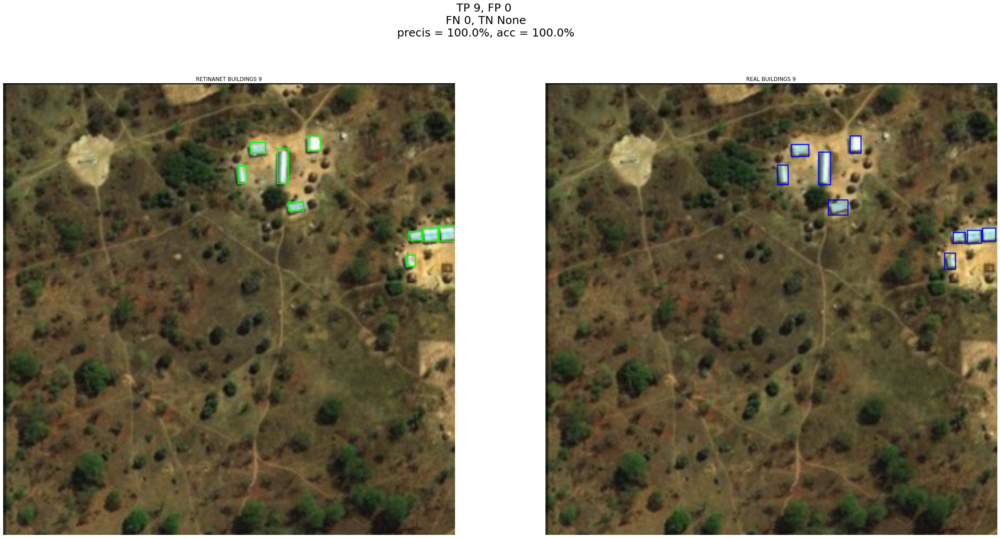

In [472]:
print('Running inference on: ' + vill)

f, ax = plt.subplots(1,2,figsize=(40, 20))

for hous in df_houss['box'].to_list():
    x1, y1, x2, y2 = hous[0],hous[1],hous[2],hous[3]
    #label = str(classes[class_ids[i]])
    label = ""
    color = (255, 0, 0)
    #cv2.rectangle(imagen, start point, end point, color, grosor de la línea)
    cv2.rectangle(image, (x1, y1), (x2, y2), color, 1)


plt.axis('off')
ax[0].imshow(cv2.cvtColor(im_draw,cv2.COLOR_BGR2RGB))
ax[1].imshow(cv2.cvtColor(image,cv2.COLOR_BGR2RGB))
ax[0].axis('off')
ax[1].axis('off')

ax[0].set_title('RETINANET BUILDINGS {}'.format(len(boxes)))
ax[1].set_title('REAL BUILDINGS {}'.format(real_b))


title= 'TP {}, FP {}\n FN {}, TN {}\n precis = {}%, acc = {}%'
plt.suptitle(title.format(true_pos,false_pos,false_neg,None,round(100*pr,2),round(acc*100,2)),fontsize=25)

plt.show()

### ON TEST DATA

In [457]:
test_path = '/Users/daniel/OAN/SID/dataset/test/'
df_anot_test = pd.read_csv(test_path+'_annotations.csv',header=None)
df_anot_test.columns = ['im_path','l','t','r','b','type']

df_anot_test['box'] = df_anot_test.apply(lambda x: (x['l'],x['t'],x['r'],x['b']),axis=1)

In [458]:
images_test = [jpg for jpg in os.listdir(test_path) 
               if 'jpg' in jpg]

In [460]:
len(images_test)

37

In [ ]:
tps = []
fps = []
fns = []
im_root_path = test_path

show_images = True


for im in images_test:
    df_houss = df_anot_test[df_anot_test['im_path'] == im]
    im_path = im_root_path + im

    image_t_det = cv2.imread(im_path)

    im_draw,boxes,box_tp = detect_houses_int(image_t_det,im,df_anot_test)
    im_draw = cv2.cvtColor(im_draw, cv2.COLOR_BGR2RGB)
    
    image = cv2.cvtColor(image_t_det, cv2.COLOR_BGR2RGB)

    real_b = df_houss.shape[0]

    true_pos = len(box_tp)
    false_pos = len(boxes)-len(box_tp)
    false_neg = real_b-len(box_tp)
    tps.append(true_pos)
    fps.append(false_pos)
    fns.append(false_neg)
    pr, acc, f1 = compute_metrics(true_pos, false_pos, false_neg)

    if show_images:
        print('Running inference on: ' + im)
        
        f, ax = plt.subplots(1,2,figsize=(40, 20))

        for hous in df_houss['box'].to_list():
            x1, y1, x2, y2 = hous[0],hous[1],hous[2],hous[3]
            #label = str(classes[class_ids[i]])
            label = ""
            color = (255, 0, 0)
            #cv2.rectangle(imagen, start point, end point, color, grosor de la línea)
            cv2.rectangle(image, (x1, y1), (x2, y2), color, 1)


        plt.axis('off')
        ax[0].imshow(im_draw)
        ax[1].imshow(image)
        ax[0].axis('off')
        ax[1].axis('off')

        ax[0].set_title('RETINANET BUILDINGS {}'.format(len(boxes)))
        ax[1].set_title('REAL BUILDINGS {}'.format(real_b))


        title= 'TP {}, FP {}\n FN {}, TN {}\n precis = {}%, acc = {}%'
        plt.suptitle(title.format(true_pos,false_pos,false_neg,None,round(100*pr,2),round(acc*100,2)),fontsize=25)

        plt.show()

In [480]:
print('TP {}, FP {} FN {}'.format(sum(tps),sum(fps),sum(fns)))
pr, acc, f1 = compute_metrics(sum(tps),sum(fps),sum(fns))
print('precis = {}%, acc = {}%, f1 = {}%'.format(round(100*pr,2),round(acc*100,2),round(f1*100,2)))

TP 281, FP 234 FN 459
precis = 54.56%, acc = 37.97%, f1 = 44.78%


In [470]:
model = 'HLS'
if model == 'HSV':
    csv_col = cv2.COLOR_BGR2HSV
    csv_col_inv = cv2.COLOR_HSV2BGR    
    c_sat = 1
    c_hue = 0
    white = [0,0,255]
    black = [0,0,0]
elif model == 'HLS':
    csv_col = cv2.COLOR_BGR2HLS
    csv_col_inv = cv2.COLOR_HLS2BGR
    white = [255,255,255]
    black = [0,0,0]
    c_sat = 2
    c_hue = 0
    
im_test = cv2.cvtColor(image,csv_col)

In [479]:
im_test_mask = []
#GRAYS

sat_gray_up = 40
mask_gray = im_test.copy()
mask_gray_m = im_test.copy()
mask_gray[mask_gray_m[:,:,c_sat] <= sat_gray_up] = white
mask_gray[np.logical_not(mask_gray_m[:,:,c_sat] <= sat_gray_up)] = black



im_test_mask.append(mask_gray)


##BLUES

b_hue_low= 120
b_hue_up = 240
mask_blues = im_test.copy()
mask_blues_m = im_test.copy()
mask_blues[mask_blues_m[:,:,c_hue] <= b_hue_low] = black
mask_blues[b_hue_low < mask_blues_m[:,:,c_hue]] = white
mask_blues[b_hue_up <= mask_blues_m[:,:,c_hue]] = black



im_test_mask.append(mask_blues)

In [480]:
im_test_mask_sum = np.zeros(shape = im_test.shape)
for i,elem in enumerate(im_test_mask):
    im_test_mask_sum = np.add(im_test_mask_sum,elem)

In [481]:
im_test_mask_sum = im_test_mask_sum.astype(np.uint8)

In [482]:
im_test_bgr = cv2.cvtColor(im_test,csv_col_inv)

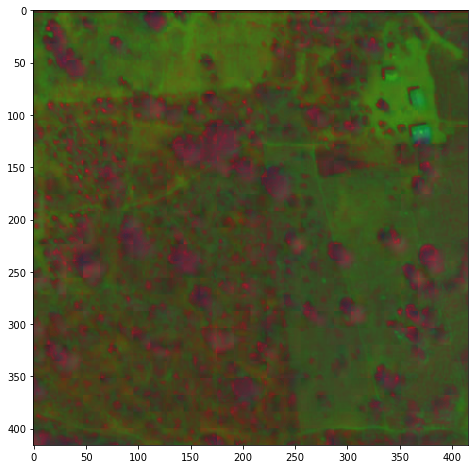

In [483]:
display(im_test)

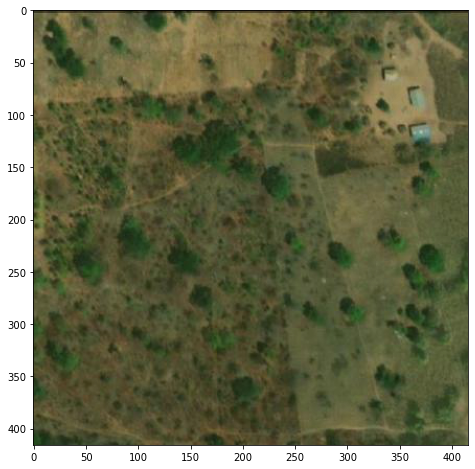

In [484]:
display(im_test_bgr)

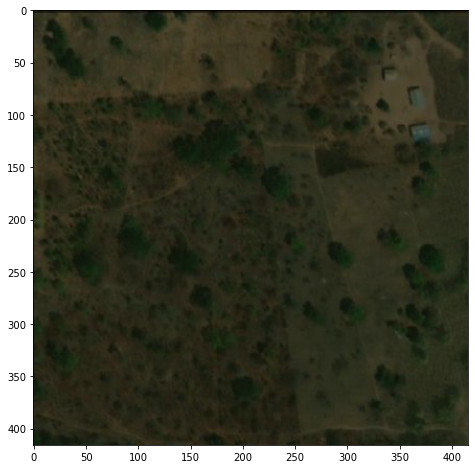

In [485]:
##BLUES
display((cv2.cvtColor(mask_blues,csv_col_inv)*0.5+im_test_bgr*0.5).astype('uint8'))

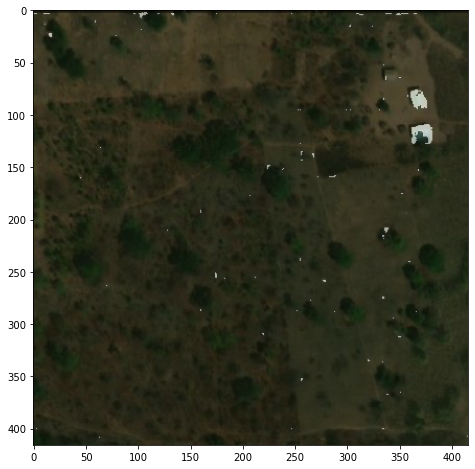

In [486]:
##GRAYs
display((cv2.cvtColor(mask_gray,csv_col_inv)*0.5+im_test_bgr*0.5).astype('uint8'))

### method not working

## GET GRAY COLORS

In [487]:
vills = [vil for vil in images_routes if vil.split('.')[0] == '1JhDdg8O_fosVOdn6szTA3mMPmg10InAp_2_png']
print(vill)

17_JPG.rf.e817cc606bffb7bdd1691ac7650cffa1.jpg


In [488]:
vill = vills[0]

In [489]:
image = cv2.imread(train_path+vill)

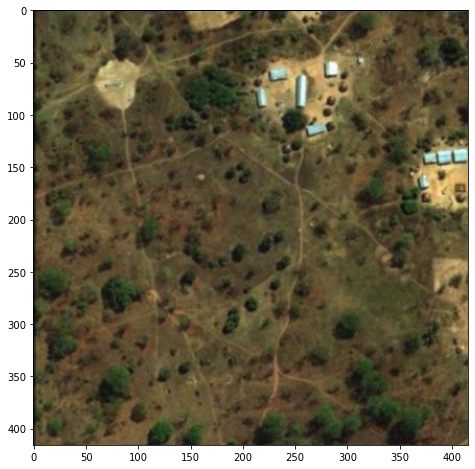

In [490]:
display(image)

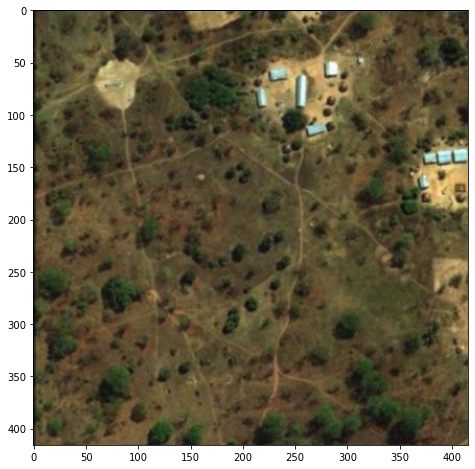

In [491]:
display(image)

In [492]:
image.shape

(416, 416, 3)

In [493]:
image[:,:,0].shape

(416, 416)

In [494]:
hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HLS)
# define range of blue color in HSV
lower_blue = np.array([180,0,50])
upper_blue = np.array([0,0,100])
# Threshold the HSV image to get only blue colors
mask = cv2.inRange(hsv, lower_blue, upper_blue)
# Bitwise-AND mask and original image
res = cv2.bitwise_and(image,image, mask= mask)


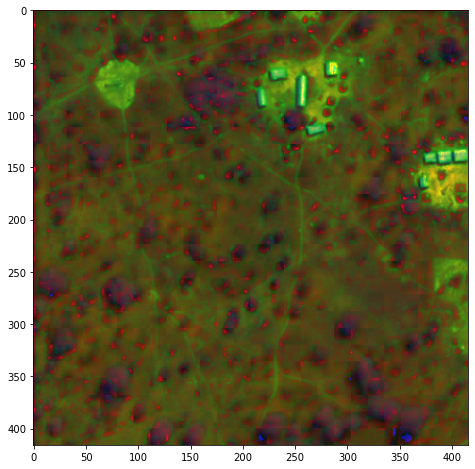

In [495]:
display(hsv)

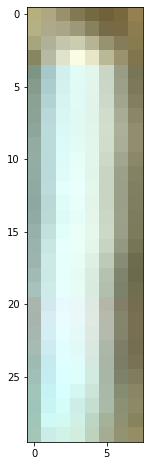

In [508]:
display(cv2.cvtColor(hsv[60:90,255:263,:],cv2.COLOR_HLS2BGR))

In [497]:
hsv[60:90,255:263,:]

array([[[ 26, 154,  72],
        [ 25, 152,  54],
        [ 23, 132,  48],
        [ 24, 106,  58],
        [ 23,  91,  73],
        [ 22,  84,  85],
        [ 22,  90,  86],
        [ 21, 114,  76]],

       [[ 27, 158,  61],
        [ 27, 156,  44],
        [ 27, 152,  42],
        [ 26, 139,  40],
        [ 26, 114,  47],
        [ 23,  95,  62],
        [ 22,  94,  72],
        [ 22, 110,  70]],

       [[ 29, 146,  48],
        [ 33, 164,  38],
        [ 30, 184,  47],
        [ 31, 190,  60],
        [ 27, 166,  49],
        [ 26, 131,  41],
        [ 23, 112,  52],
        [ 23, 108,  65]],

       [[ 30, 115,  42],
        [ 35, 174,  36],
        [ 35, 215,  79],
        [ 33, 240, 222],
        [ 29, 216, 100],
        [ 28, 169,  53],
        [ 25, 131,  45],
        [ 23, 103,  64]],

       [[ 69, 137,  23],
        [ 91, 184,  62],
        [ 88, 224, 123],
        [ 84, 238, 197],
        [ 74, 236, 134],
        [ 53, 206,  44],
        [ 35, 145,  27],
        [ 27, 104

In [68]:
### FROM SATURATION CHANNEL

<AxesSubplot:>

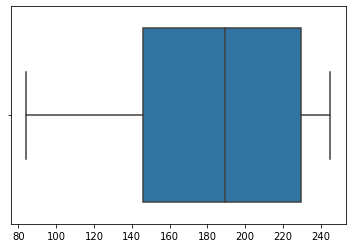

In [499]:
sns.boxplot(x=np.ravel(hsv[60:90,255:263,1]))

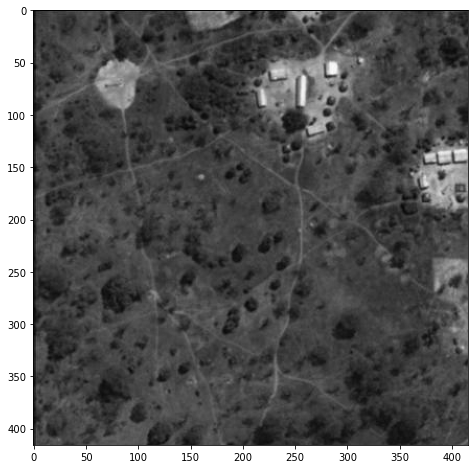

In [500]:
display(hsv[:,:,1])

(array([ 4575., 30744., 86797., 38657.,  4800.,  3728.,  2621.,   692.,
          273.,   169.]),
 array([  0. ,  25.3,  50.6,  75.9, 101.2, 126.5, 151.8, 177.1, 202.4,
        227.7, 253. ]),
 <BarContainer object of 10 artists>)

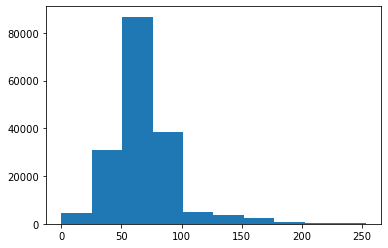

In [501]:
plt.hist(np.ravel(hsv[:,:,1]))

In [502]:
gray_image = hsv[:,:,1]

In [503]:
ret, sep_thresh = cv2.threshold(gray_image,180,255,cv2.THRESH_BINARY)

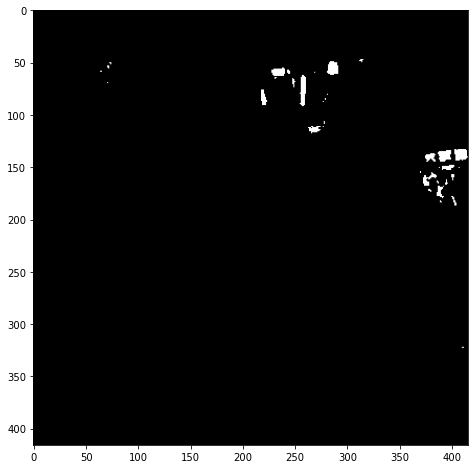

In [504]:
display(sep_thresh)

### FROM COLOR

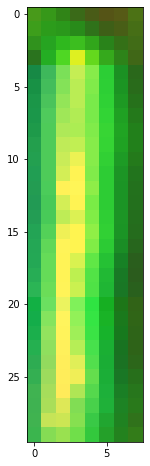

In [505]:
display(hsv[60:90,255:263,:])

In [506]:
hsv[60:90,255:263,0]

array([[26, 25, 23, 24, 23, 22, 22, 21],
       [27, 27, 27, 26, 26, 23, 22, 22],
       [29, 33, 30, 31, 27, 26, 23, 23],
       [30, 35, 35, 33, 29, 28, 25, 23],
       [69, 91, 88, 84, 74, 53, 35, 27],
       [69, 91, 88, 84, 74, 53, 35, 27],
       [72, 91, 88, 84, 74, 53, 35, 27],
       [74, 92, 88, 84, 74, 53, 35, 27],
       [74, 89, 88, 83, 74, 52, 35, 27],
       [77, 89, 88, 83, 74, 52, 35, 27],
       [80, 89, 88, 83, 74, 52, 37, 27],
       [83, 89, 86, 83, 74, 52, 37, 29],
       [82, 90, 87, 87, 72, 52, 37, 29],
       [84, 88, 86, 83, 70, 52, 37, 29],
       [84, 88, 86, 83, 70, 52, 37, 29],
       [85, 88, 86, 80, 70, 52, 37, 29],
       [85, 88, 88, 80, 70, 52, 37, 29],
       [85, 88, 86, 80, 70, 52, 37, 29],
       [85, 88, 86, 80, 70, 52, 37, 29],
       [85, 88, 88, 80, 70, 52, 37, 29],
       [68, 96, 95, 90, 66, 34, 24, 23],
       [74, 94, 93, 88, 68, 38, 28, 23],
       [76, 94, 91, 88, 69, 43, 29, 24],
       [80, 94, 91, 86, 76, 51, 33, 24],
       [82, 94, 

In [68]:
### FROM SATURATION CHANNEL

/opt/anaconda3/envs/sid/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:>

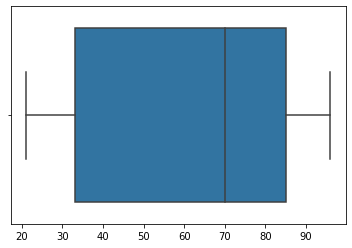

In [88]:
boxplot(np.ravel(hsv[60:90,255:263,0]))

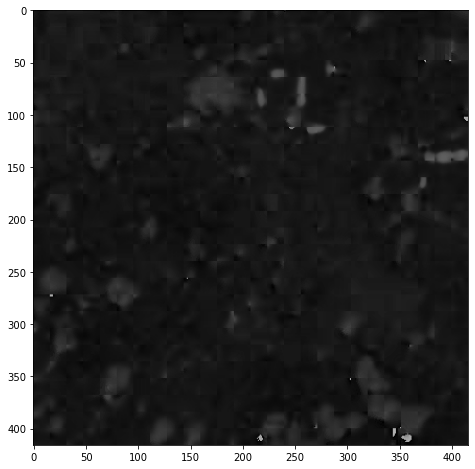

In [509]:
display(hsv[:,:,0])

(array([2.59390e+04, 1.33123e+05, 1.16040e+04, 1.51800e+03, 5.78000e+02,
        1.64000e+02, 1.30000e+01, 8.00000e+00, 5.00000e+00, 1.04000e+02]),
 array([  0. ,  17.7,  35.4,  53.1,  70.8,  88.5, 106.2, 123.9, 141.6,
        159.3, 177. ]),
 <BarContainer object of 10 artists>)

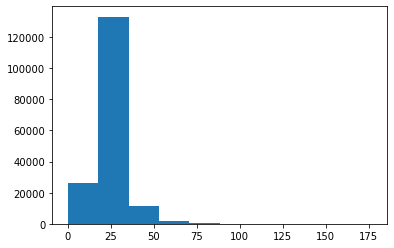

In [510]:
plt.hist(np.ravel(hsv[:,:,0]))

In [511]:
gray_image = hsv[:,:,0]

In [512]:
ret, sep_thresh = cv2.threshold(gray_image,60,255,cv2.THRESH_BINARY)

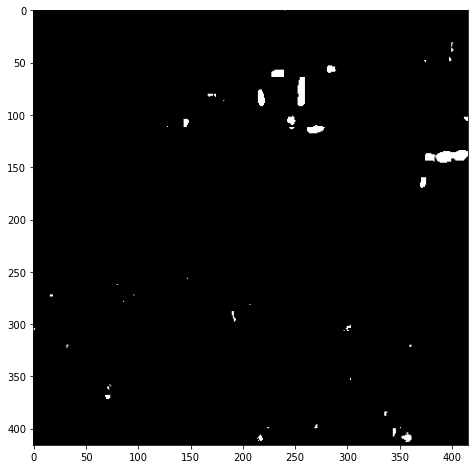

In [513]:
display(sep_thresh)

#### Step 6: Grab Background that you are sure of

In [514]:
kernel = np.ones(shape=(5,5))

In [515]:
# sure background area
#sure_bg = cv2.dilate(sep_thresh,kernel,iterations=1)
sure_bg = sep_thresh

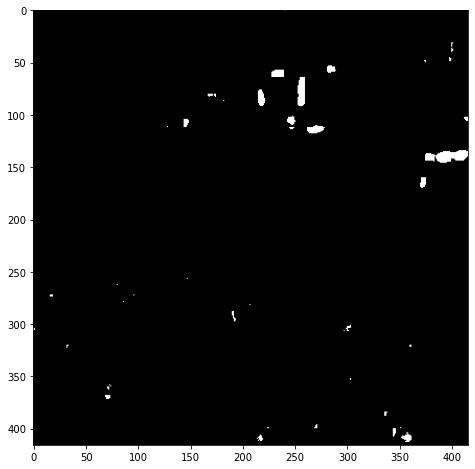

In [516]:
display(sure_bg,cmap='gray')

#### Step 11: Find Contours on Markers

In [517]:
img = image.copy()
contours, hierarchy = cv2.findContours(sure_bg.copy(), cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)

houses = []
# For every entry in contours
for i,c in enumerate(contours):
    
    # last column in the array is -1 if an external contour (no contours inside of it)
    if hierarchy[0][i][3] == -1:
        if 20 < c.size:
        
            # We can now draw the external contours from the list of contours
            cv2.drawContours(img, contours, i, (255, 0, 0), 1)

            M = cv2.moments(c)
            cX = int(M["m10"] / M["m00"])
            cY = int(M["m01"] / M["m00"])
            cv2.circle(img, (cX, cY), 2, (0, 0, 255), -1)
            houses.append(c)

In [518]:
len(houses)

10

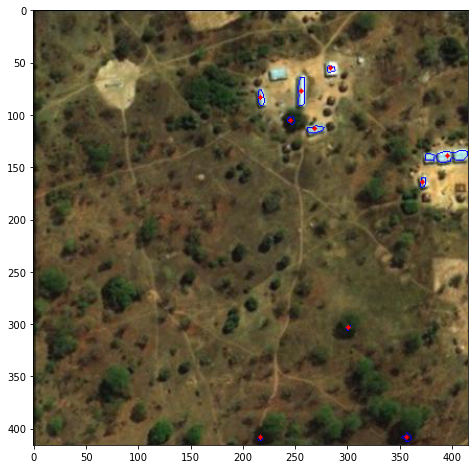

In [519]:
display(img)

#### Step 6: Grab Background that you are sure of

In [520]:
# sure background area
sure_bg_2 = cv2.dilate(sep_thresh,kernel,iterations=0)

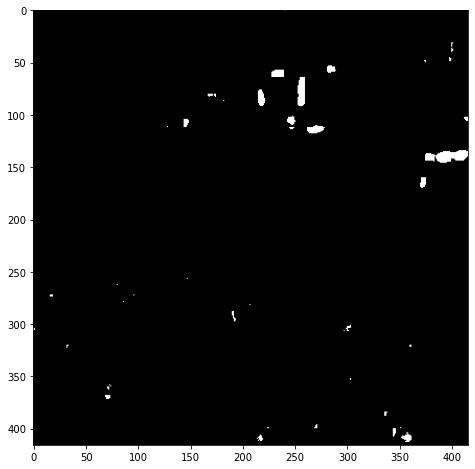

In [521]:
display(sure_bg_2,cmap='gray')

#### Step 7: Find Sure Foreground

In [522]:
# Finding sure foreground area
dist_transform = cv2.distanceTransform(sure_bg_2,cv2.DIST_L2,5)
ret, sure_fg_2 = cv2.threshold(dist_transform,0.3*dist_transform.max(),255,0)

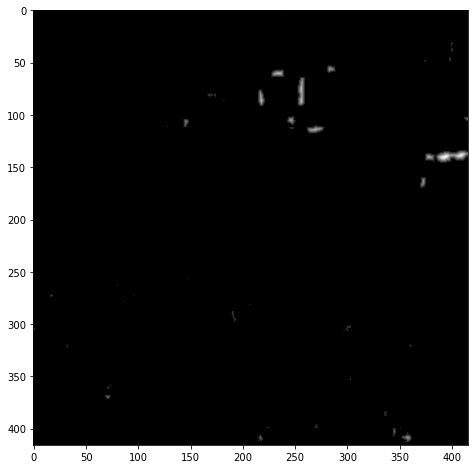

In [523]:
display(dist_transform,cmap='gray')

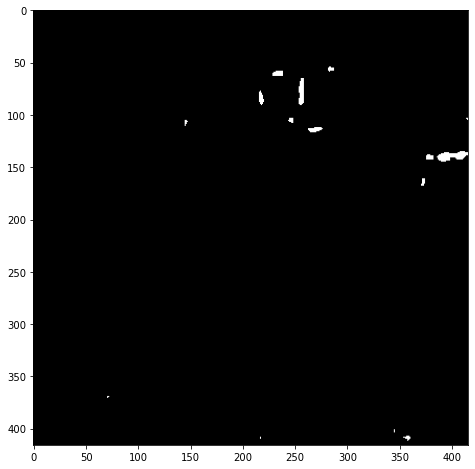

In [524]:
display(sure_fg_2,cmap='gray')

#### Step 8: Find Unknown Region

In [525]:
# Finding unknown region
sure_fg_2 = np.uint8(sure_fg_2)
unknown = cv2.subtract(sure_bg_2,sure_fg_2)

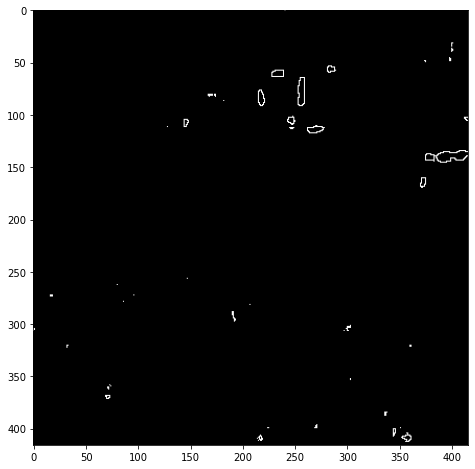

In [526]:
display(unknown,cmap='gray')

#### Step 9: Label Markers of Sure Foreground

In [527]:
# Marker labelling
ret, markers = cv2.connectedComponents(sure_fg_2)
# Add one to all labels so that sure background is not 0, but 1
markers = markers+1
# Now, mark the region of unknown with zero
markers[unknown==255] = 0

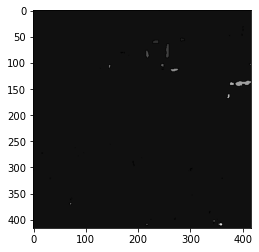

In [528]:
plt.imshow(markers,cmap='gray')

#### Step 10: Apply Watershed Algorithm to find Markers

In [529]:
markers = cv2.watershed(img,markers)

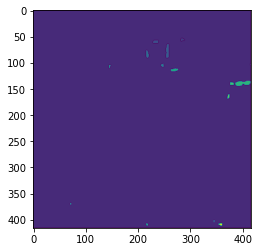

In [530]:
plt.imshow(markers)

#### Step 11: Find Contours on Markers

In [531]:
img_brut = image.copy()
contours, hierarchy = cv2.findContours(markers.copy(), cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)

# For every entry in contours
for i,c in enumerate(contours):
    
    # last column in the array is -1 if an external contour (no contours inside of it)
    if hierarchy[0][i][3] == -1:
        
        # We can now draw the external contours from the list of contours
        cv2.drawContours(img_brut, contours, i, (255, 0, 0), 1)
        
        M = cv2.moments(c)
        if 0 != M["m00"]:
            cX = int(M["m10"] / M["m00"])
            cY = int(M["m01"] / M["m00"])
            cv2.circle(img_brut, (cX, cY), 1, (0, 0, 255), -1)

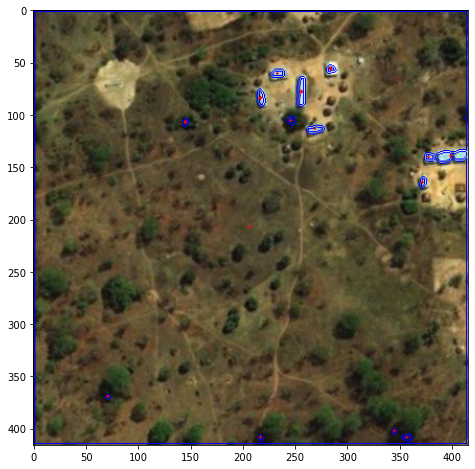

In [532]:
display(img_brut)

## combination of HSV and HLS

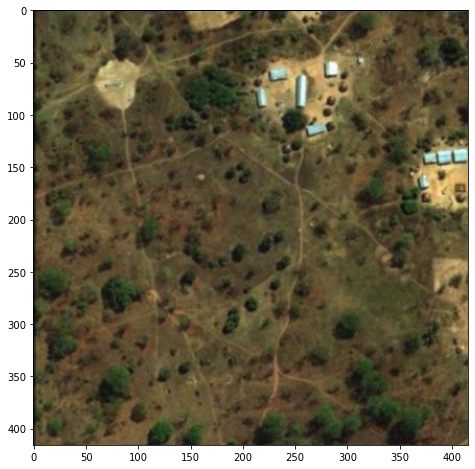

In [533]:
display(image)

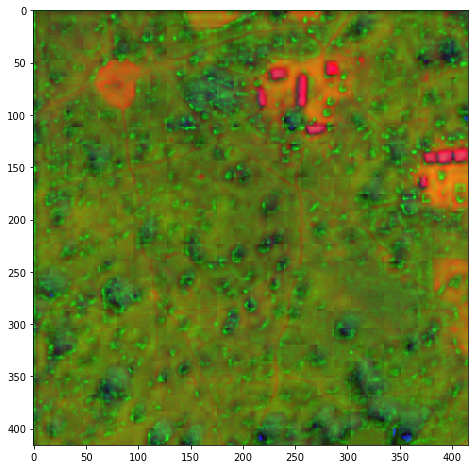

In [534]:
hsv = cv2.cvtColor(image,cv2.COLOR_BGR2HSV)
display(hsv)

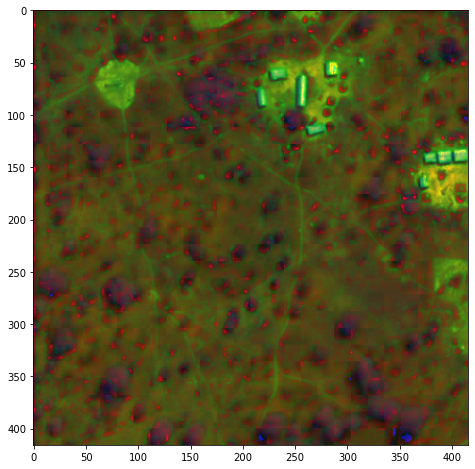

In [535]:
hls = cv2.cvtColor(image,cv2.COLOR_BGR2HLS)
display(hls)

In [536]:
(hsv[:,:,2]+hls[:,:,1]).max()*2

510

In [537]:
image_hsl = (np.where(200 < hsv[:,:,2],hsv[:,:,2],0).astype(np.int32)
             +2*hls[:,:,1].astype(np.int32)
             +4*hls[:,:,0].astype(np.int32))

In [538]:
image_hsl = (255*image_hsl/image_hsl.max()).astype(np.uint8)

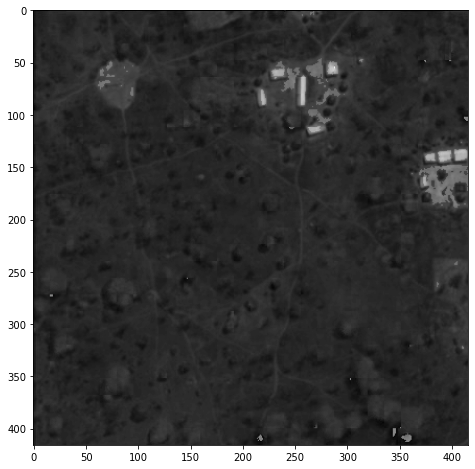

In [539]:
display(image_hsl,'gray')

In [540]:
th, im_gay = cv2.threshold(image_hsl,150,255,cv2.THRESH_BINARY)

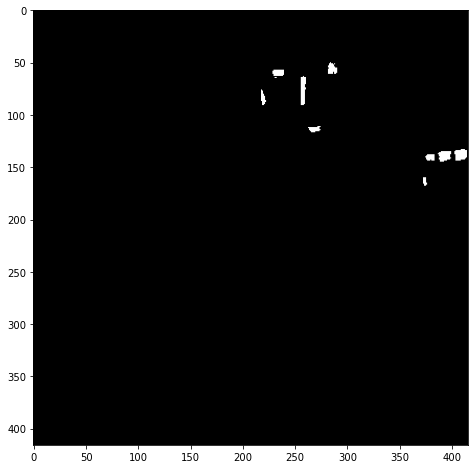

In [541]:
display(im_gay,'gray')

#### Step 6: Grab Background that you are sure of

In [542]:
# sure background area
sure_bg_2 = cv2.dilate(im_gay,kernel,iterations=0)

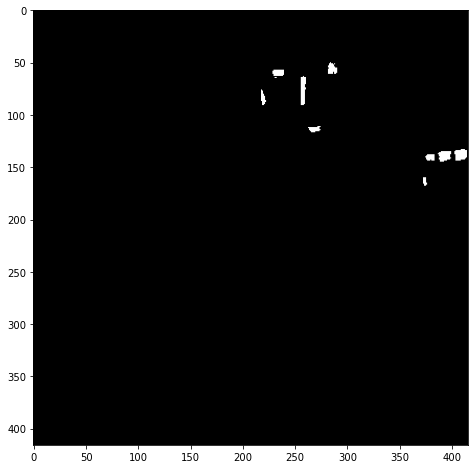

In [543]:
display(sure_bg_2,cmap='gray')

#### Step 11: Find Contours on Markers

In [544]:
houses = []
img_brut = image.copy()
contours, hierarchy = cv2.findContours(sure_bg_2.copy(), cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)

# For every entry in contours
for i,c in enumerate(contours):
    
    # last column in the array is -1 if an external contour (no contours inside of it)
    if hierarchy[0][i][3] == -1:
        
        if 10 < c.size: 
            #print(c.size)
            rect = cv2.minAreaRect(c)
            box = cv2.boxPoints(rect)
            box = np.int0(box)
            x, y = np.min(box,axis=0)
            x_max, y_max = np.max(box,axis=0)
            w, h = x_max -x, y_max - y

            cx = x+w//2
            cy = y+h//2
            cr  = max(w,h)//2

            ## set offset, repeat enlarger ROI
            dr = 2
            dw = w//2+1*dr
            dh = h//2+1*dr
            cv2.rectangle(img_brut, (cx-dw, cy-dh), (cx+dw, cy+dh), (0,255,0), 1)


            #cv2.drawContours(img_brut,[box],0,(0,0,255),2)
            # We can now draw the external contours from the list of contours
            #cv2.drawContours(img_brut, contours, i, (255, 0, 0), 1)

            M = cv2.moments(c)
            if 0 != M["m00"]:
                cX = int(M["m10"] / M["m00"])
                cY = int(M["m01"] / M["m00"])
                cv2.circle(img_brut, (cX, cY), 1, (0, 0, 255), -1)
                
            houses.append(box)

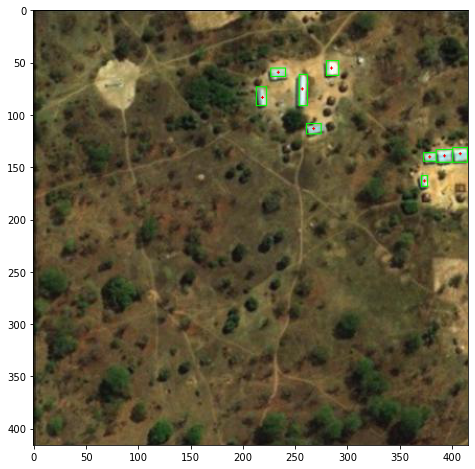

In [545]:
display(img_brut)

### DEFINE IN A FUNCTION

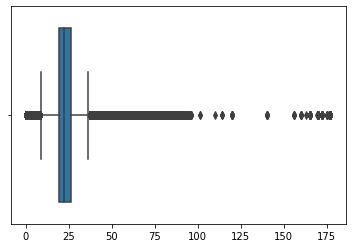

In [745]:
a = sns.boxplot(x=np.ravel(hls[:,:,0]))


### TRAIN AND GET BEST PARAMS

### EVALUATION

In [938]:
def jaccard(b, a):
    """box_X is a tuple of the shape (x1, y1, x2, y2)."""
    side1 = max(0, min(a[2], b[2]) - max(a[0], b[0]))
    side2 = max(0, min(a[3], b[3]) - max(a[1], b[1]))
    inter = side1 * side2
    
    area_a = (a[2] - a[0]) * (a[3] - a[1])
    area_b = (b[2] - b[0]) * (b[3] - b[1])
    union = area_a + area_b - inter
    
    return inter / union


def is_valid(box_pred, box_true, threshold=0.2):
    return jaccard(box_pred, box_true) >= threshold

In [939]:
def compute_metrics(true_pos, false_pos, false_neg):
    if (true_pos + false_neg) == 0 or false_pos+true_pos == 0:
        return 0, 0, 0
    """Compute the precision, recall, and f1 score."""
    precision = true_pos / (true_pos + false_pos)
    recall = true_pos / (true_pos + false_neg)

    if precision == 0 or recall == 0:
        return precision, recall, 0

    f1 = 2 / (1 / precision + 1 / recall)
    return precision, recall, f1

In [1388]:
im_path = '17_JPG.rf.e817cc606bffb7bdd1691ac7650cffa1.jpg'
#im_path = '1DSneo4A8uBgd9QQJF-npDiLdjBHpfrpT_2_png.rf.32e3e38fc6cd08bc77f69752fc01788f.jpg'
image_g_det = cv2.imread(train_path+'/'+im_path)

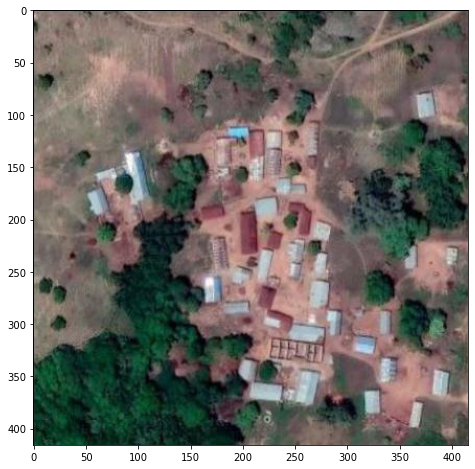

In [1389]:
display(image_g_det)

In [1390]:
c_hue

0

In [1391]:
mask_non_red.shape

(416, 416)

In [1392]:
np.sum(mask_non_red.astype(np.int64)).astype(np.int64)

0

In [1393]:
hsv = cv2.cvtColor(image_g_det,cv2.COLOR_BGR2HLS)
suma_pixel = []
for i in np.arange(8,25,1):
    b_hue_low= 10*i
    b_hue_up = 255
    mask_non_red = image_g_det.copy()
    mask_non_red_m = image_g_det.copy()
    mask_non_red[mask_non_red_m[:,:,c_hue] <= b_hue_low] = [0,0,0]
    mask_non_red[b_hue_low <= mask_non_red_m[:,:,c_hue]] = [255,255,255]
    mask_non_red[b_hue_up <= mask_non_red_m[:,:,c_hue]] = [0,0,0]

    mask_non_red = mask_non_red[:,:,0]
    
    suma = np.sum(mask_non_red.astype(np.int64)).astype(np.int64)
    
    suma_pixel.append({'suma':suma,'b_down':b_hue_low})



In [1394]:
df_suma =pd.DataFrame(suma_pixel)

In [1395]:
df_suma['diff'] = df_suma['suma'].diff().abs()
df_suma['diff_diff'] = df_suma['diff'].diff().abs()

<AxesSubplot:xlabel='b_down', ylabel='suma'>

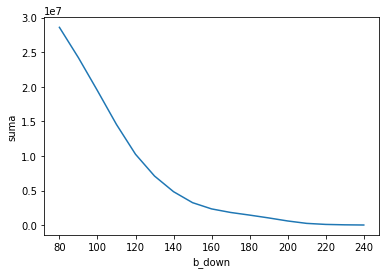

In [1399]:
sns.lineplot(x='b_down',y='suma',data=df_suma)

<AxesSubplot:xlabel='b_down', ylabel='diff'>

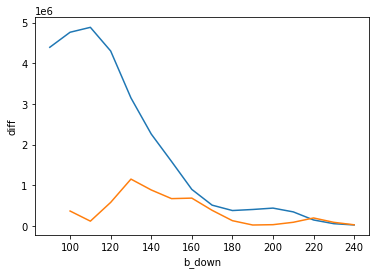

In [1400]:

sns.lineplot(x='b_down',y='diff',data=df_suma)
sns.lineplot(x='b_down',y='diff_diff',data=df_suma)

In [1397]:
df_suma[df_suma['diff_diff'].max() == df_suma['diff_diff']]

,suma,b_down,diff,diff_diff
5,7099710,130,3147720.0,1153620.0


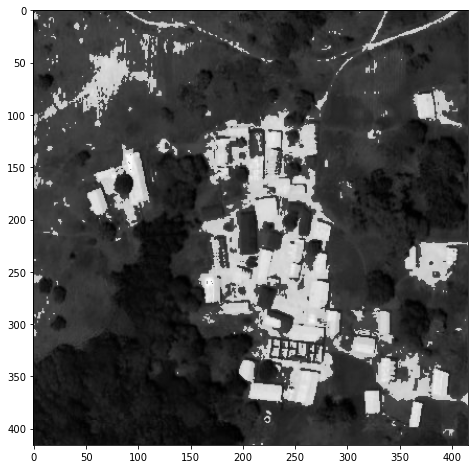

In [1398]:
b_hue_low= 130
b_hue_up = 255
mask_non_red = image_g_det.copy()
mask_non_red_m = image_g_det.copy()
mask_non_red[mask_non_red_m[:,:,c_hue] <= b_hue_low] = [0,0,0]
mask_non_red[b_hue_low <= mask_non_red_m[:,:,c_hue]] = [255,255,255]
mask_non_red[b_hue_up <= mask_non_red_m[:,:,c_hue]] = [0,0,0]

mask_non_red = mask_non_red[:,:,0]

display((mask_non_red*0.5+cv2.cvtColor(image_g_det,cv2.COLOR_BGR2GRAY)*0.5).astype(np.uint8))

In [806]:
vill = random.choice(images_routes)
vill

'89_JPG.rf.5335e5de564c7ca99771286f32adb943.jpg'

In [807]:
im_path = '17_JPG.rf.e817cc606bffb7bdd1691ac7650cffa1.jpg'
im_path = '1DSneo4A8uBgd9QQJF-npDiLdjBHpfrpT_2_png.rf.32e3e38fc6cd08bc77f69752fc01788f.jpg'
im_path = '1cYSdXb-6dhVYmmlya0EKIEnzYWN5XFVk_8_png.rf.32a105fd55ce3b51d7c3e948d9f8eb8a.jpg'
im_path = '1JhDdg8O_fosVOdn6szTA3mMPmg10InAp_2_png.rf.091d43b26e849f0da04ff6ea9ff4150f.jpg'

im_path = vill
image_g_det = cv2.imread(train_path+'/'+im_path)

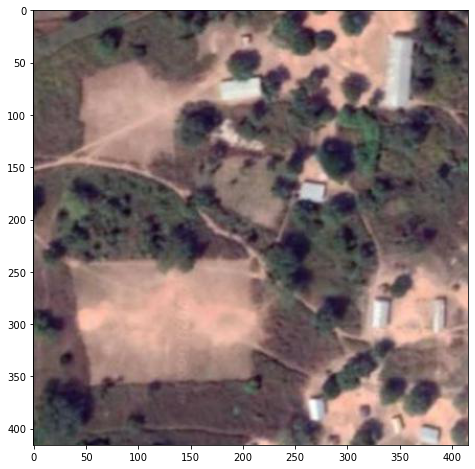

In [808]:
display(image_g_det)

In [809]:
v = image_g_det
hsv = cv2.cvtColor(v,cv2.COLOR_BGR2HLS)
suma_pixel = []
c_hue=0
for i in np.arange(8,20,0.5):
    b_hue_low= 10*i
    b_hue_up = 255
    mask_non_red = v.copy()
    mask_non_red_m = v.copy()
    mask_non_red[mask_non_red_m[:,:,c_hue] <= b_hue_low] = [0,0,0]
    mask_non_red[b_hue_low <= mask_non_red_m[:,:,c_hue]] = [255,255,255]
    mask_non_red[b_hue_up <= mask_non_red_m[:,:,c_hue]] = [0,0,0]

    mask_non_red = mask_non_red[:,:,0]
    
    suma = np.sum(mask_non_red.astype(np.int64)).astype(np.int64)
    
    suma_pixel.append({'suma':suma,'b_down':b_hue_low})



In [810]:
df_suma =pd.DataFrame(suma_pixel)

df_suma = df_suma[(0 < df_suma['suma']) &
                  (df_suma['suma'] < 15000000)].reset_index()

df_suma['pct_change'] = df_suma['suma'].pct_change().abs()
df_suma['pct_change_pct_change'] = df_suma['pct_change'].pct_change().abs()

df_suma['diff'] = df_suma['suma'].diff().abs()
df_suma['diff_diff'] = df_suma['diff'].diff().abs()
sns.lineplot(x='b_down',y='pct_change',data=df_suma)

In [812]:
df_suma['pct_change'] = df_suma['suma'].pct_change().abs()
df_suma['pct_change_pct_change'] = df_suma['pct_change'].pct_change().abs()


In [813]:
df_suma['diff'] = df_suma['suma'].diff().abs()
df_suma['diff_diff'] = df_suma['diff'].diff().abs()

<AxesSubplot:xlabel='b_down', ylabel='pct_change'>

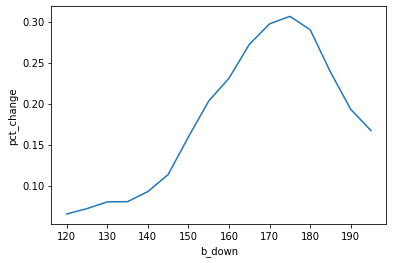

In [814]:
sns.lineplot(x='b_down',y='pct_change',data=df_suma)

In [815]:
df_pctss = df_suma['pct_change']

In [816]:
df_local_max = df_suma[(df_pctss.shift(1) < df_pctss) & 
        (df_pctss.shift(-1) < df_pctss)].sort_values(by='pct_change',
                                                                  ascending= False
                                                    ).reset_index()

In [817]:
b_hue_low = df_local_max.iloc[0]['b_down'].max()
print(b_hue_low)

175.0


<AxesSubplot:xlabel='b_down', ylabel='pct_change_pct_change'>

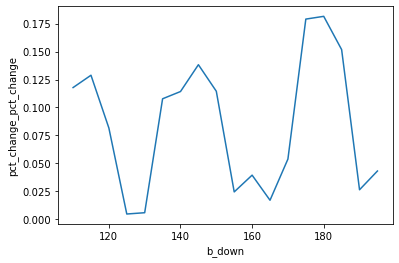

In [686]:
sns.lineplot(x='b_down',y='pct_change_pct_change',data=df_suma)

In [543]:
df_pctss = df_suma['pct_change_pct_change']

In [544]:
df_local_max = df_suma[(df_pctss.shift(1) < df_pctss) & 
        (df_pctss.shift(-1) < df_pctss)].sort_values(by='b_down',
                                                                  ascending= False
                                                    ).reset_index()

In [545]:
b_hue_low = df_local_max.iloc[min(len(df_local_max)-1,1)]['b_down'].max()
print(b_hue_low)

155.0


In [546]:
## SUMA = 264690

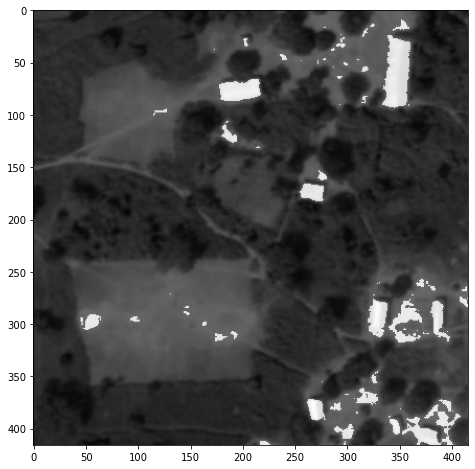

In [818]:
#b_hue_low = 120
b_hue_up = 255
mask_non_red = v.copy()
mask_non_red_m = v.copy()
mask_non_red[mask_non_red_m[:,:,c_hue] <= b_hue_low] = [0,0,0]
mask_non_red[b_hue_low <= mask_non_red_m[:,:,c_hue]] = [255,255,255]
mask_non_red[b_hue_up <= mask_non_red_m[:,:,c_hue]] = [0,0,0]

mask_non_red = mask_non_red[:,:,0]

display((mask_non_red*0.5+cv2.cvtColor(v,cv2.COLOR_BGR2GRAY)*0.5).astype(np.uint8))

In [1264]:

def detect_houses(image,vill,df_anot,v,s,l,h,verb=False):
    hsv = cv2.cvtColor(image,cv2.COLOR_BGR2HSV)
    hls = cv2.cvtColor(image,cv2.COLOR_BGR2HLS)
    
    #hue = np.where(True,255-hls[:,:,0],0)
    
    val_q =0.95
    li_q_up = 0.1
    li_q_d = 0
    sat_q_up =1
    sat_q_d =0.9
    print(np.quantile(hsv[:,:,2], val_q))
    val = np.where(min(130,np.quantile(hsv[:,:,2], val_q)) < hsv[:,:,2],hsv[:,:,2],0)
    
    # apply morphology open
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (9,9))
    val = v*cv2.morphologyEx(val, cv2.MORPH_OPEN, kernel).astype(np.int32)
    
    light = np.where(np.logical_and((np.quantile(hls[:,:,2],li_q_d) < hls[:,:,2]),
                                      (hls[:,:,2] < np.quantile(hls[:,:,2],li_q_up))
                                     ),255-hls[:,:,2],0
                      )
    
    # apply morphology open
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))
    light = l*cv2.morphologyEx(light, cv2.MORPH_OPEN, kernel).astype(np.int32)
    
    sat = np.where(np.logical_and((np.quantile(hls[:,:,1],sat_q_d) < hls[:,:,1]),
                                      (hls[:,:,1] < np.quantile(hls[:,:,1],sat_q_up))
                                     ),hls[:,:,1],0
                      )
    
     # apply morphology open
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5,5))
    sat = s*cv2.morphologyEx(sat, cv2.MORPH_OPEN, kernel).astype(np.int32)
    
    
    b_hue_low= 40
    b_hue_up = 60
    mask_non_red = hsv.copy()
    mask_non_red_m = hsv.copy()
    mask_non_red[mask_non_red_m[:,:,c_hue] <= b_hue_low] = [0,0,0]
    mask_non_red[b_hue_low <= mask_non_red_m[:,:,c_hue]] = [255,255,255]
    mask_non_red[b_hue_up <= mask_non_red_m[:,:,c_hue]] = [0,0,0]
    
    mask_non_red = mask_non_red[:,:,0]
    if verb:
        display(mask_non_red)
     # apply morphology open
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))
    mask_non_red = cv2.morphologyEx(mask_non_red, cv2.MORPH_OPEN, kernel)
    
    
    
    th, mask_non_red = cv2.threshold(mask_non_red,100,255,cv2.THRESH_BINARY)
    
    mask_non_red = h*mask_non_red.astype(np.int32)
    
    image_hsl = (val +light +sat+ mask_non_red)
    
    if verb:
        display(hsv)
        display(val,'gray')
        display(hls)
        display(light,'gray')
        display(sat,'gray')
        display(mask_non_red,'gray')
        
        print(np.unique(np.ravel(mask_non_red),return_counts=True))
    
    
    image_hsl = (255*image_hsl.astype(np.float32)/image_hsl.max()).astype(np.uint8)
    
    if verb:
        display(image_hsl)
    
    th, im_gay = cv2.threshold(image_hsl,140,255,cv2.THRESH_BINARY)
    
    if verb:
        display(im_gay)
        
    

    # apply morphology open
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5,5))
    im_gay = cv2.morphologyEx(im_gay, cv2.MORPH_OPEN, kernel)
    
    if verb:
        display(im_gay)
        
    # apply morphology close
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))
    im_gay = cv2.morphologyEx(im_gay, cv2.MORPH_CLOSE, kernel)
    
    if verb:
        display(im_gay)

    # apply morphology erode
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3,3))
    #im_gay = cv2.morphologyEx(im_gay, cv2.MORPH_ERODE, kernel)
    
    #if verb:
        #display(im_gay)
    
    # apply morphology dilate
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5,5))
    im_gay = cv2.morphologyEx(im_gay, cv2.MORPH_DILATE, kernel)
    
    if verb:
        display(im_gay)
    

    houses = []
    box_tp = []
    im_draw = image.copy()
    contours, hierarchy = cv2.findContours(im_gay.copy(), cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)
    
    
    df_houss = df_anot[df_anot['im_path'] == vill]

    # For every entry in contours
    for i,c in enumerate(contours):

        # last column in the array is -1 if an external contour (no contours inside of it)
        if hierarchy[0][i][3] == -1:

            if 10 < c.size and c.size < 200 : 
                #print(c.size)
                rect = cv2.minAreaRect(c)
                box = cv2.boxPoints(rect)
                box = np.int0(box)
                x, y = np.min(box,axis=0)
                x_max, y_max = np.max(box,axis=0)
                
                bbox = (x,y,x_max,y_max)
                w, h = x_max -x, y_max - y

                cx = x+w//2
                cy = y+h//2
                cr  = max(w,h)//2

                ## set offset, repeat enlarger ROI
                dr = 2
                dw = w//2+1*dr
                dh = h//2+1*dr
                ##EVALUATION
                bool_tp = df_houss['box'].apply(lambda x: is_valid(bbox,x)).any()
                if bool_tp:
                    box_tp.append(bbox)
                    cv2.rectangle(im_draw, (cx-dw, cy-dh), (cx+dw, cy+dh), (0,255,0), 1)
                else:
                    cv2.rectangle(im_draw, (cx-dw, cy-dh), (cx+dw, cy+dh), (0,0,255), 1)


                #cv2.drawContours(im_draw,[box],0,(0,0,255),2)
                # We can now draw the external contours from the list of contours
                #cv2.drawContours(im_draw, contours, i, (255, 0, 0), 1)

               #M = cv2.moments(c)
               #if 0 != M["m00"]:
               #    cX = int(M["m10"] / M["m00"])
               #    cY = int(M["m01"] / M["m00"])
               #    cv2.circle(im_draw, (cX, cY), 1, (0, 0, 255), -1)
               #    
                    
                        
                    
                    

                houses.append(box)
                
                
                    
                    
                
    #display(im_draw)
    
    return im_draw,houses,box_tp

In [895]:
df_anot['box'] = df_anot.apply(lambda x: (x['l'],x['t'],x['r'],x['b']),axis=1)

In [896]:
df_anot

,im_path,l,t,r,b,type,house,house_pixels_nw,box
0,17_JPG.rf.e817cc606bffb7bdd1691ac7650cffa1.jpg,305,310,329,330,buildings,"[[305, 310], [305, 330], [329, 330], [329, 310]]","[[2, 154, 40], [103, 165, 96], [105, 155, 69],...","(305, 310, 329, 330)"
1,17_JPG.rf.e817cc606bffb7bdd1691ac7650cffa1.jpg,243,298,279,320,buildings,"[[243, 298], [243, 320], [279, 320], [279, 298]]","[[3, 129, 11], [5, 96, 17], [95, 177, 36], [95...","(243, 298, 279, 320)"
2,17_JPG.rf.e817cc606bffb7bdd1691ac7650cffa1.jpg,329,284,343,312,buildings,"[[329, 284], [329, 312], [343, 312], [343, 284]]","[[0, 111, 16], [0, 150, 15], [0, 172, 0], [1, ...","(329, 284, 343, 312)"
3,17_JPG.rf.e817cc606bffb7bdd1691ac7650cffa1.jpg,278,284,296,312,buildings,"[[278, 284], [278, 312], [296, 312], [296, 284]]","[[98, 183, 46], [156, 88, 14], [158, 88, 16], ...","(278, 284, 296, 312)"
4,17_JPG.rf.e817cc606bffb7bdd1691ac7650cffa1.jpg,218,284,249,308,buildings,"[[218, 284], [218, 308], [249, 308], [249, 284]]","[[1, 110, 65], [1, 155, 49], [1, 174, 88], [2,...","(218, 284, 249, 308)"
...,...,...,...,...,...,...,...,...,...
15324,36_JPG.rf.966fe6d21279426221b7208d10ce81d7.jpg,44,52,61,87,buildings,"[[44, 52], [44, 87], [61, 87], [61, 52]]","[[0, 237, 0], [6, 202, 144], [7, 192, 113], [7...","(44, 52, 61, 87)"
15325,36_JPG.rf.966fe6d21279426221b7208d10ce81d7.jpg,51,34,71,47,buildings,"[[51, 34], [51, 47], [71, 47], [71, 34]]","[[3, 130, 20], [3, 247, 165], [5, 219, 45], [6...","(51, 34, 71, 47)"
15326,1ELavSQxzU7K2ZWXIAZP8LX-zuAdIF_8s_4_png.rf.970...,228,200,240,210,buildings,"[[228, 200], [228, 210], [240, 210], [240, 200]]","[[23, 75, 92], [23, 87, 76], [26, 102, 50], [2...","(228, 200, 240, 210)"
15327,1ELavSQxzU7K2ZWXIAZP8LX-zuAdIF_8s_4_png.rf.970...,242,202,254,212,buildings,"[[242, 202], [242, 212], [254, 212], [254, 202]]","[[27, 113, 47], [27, 116, 45], [27, 116, 46], ...","(242, 202, 254, 212)"


In [548]:
images_data = pd.read_gbq('SELECT * FROM `sidhouses.osm_data.image_ds_info`')

In [549]:
images_data.head()

,drive_id,village_name,path,lat_0,lon_0,deg_per_px_lat,deg_per_px_lon,n_houses,layer
0,1ERUqn0IWwczeIWYqkTJhv61XOVB5IExf,ALAFIAROU,/Users/daniel/OAN/SID/poc/osm/ALAFIAROU.png,10.068964,3.07710,0.000005,0.000005,10,bing
1,1iRSSNT0StWUtXJqt8IMj_OUmp1sokQil,TAKOU GANDO,/Users/daniel/OAN/SID/poc/osm/TAKOU GANDO.png,9.860075,3.22100,0.000005,0.000005,19,bing
2,1JhDdg8O_fosVOdn6szTA3mMPmg10InAp,PERANGOU BAGRI - GBÈRANKOU,/Users/daniel/OAN/SID/poc/osm/PERANGOU BAGRI -...,10.120093,3.43628,0.000005,0.000005,53,bing
3,1oP0XKEsZqgwdSWrswPucb6MoXxDbNi8f,KPARISSEROU PEULH,/Users/daniel/OAN/SID/poc/osm/KPARISSEROU PEUL...,9.952434,3.14307,0.000005,0.000005,7,esri
4,1__sch8bmeRnaYZzcZiLIDxbrHiGzZYsZ,MOUSSOURE,/Users/daniel/OAN/SID/poc/osm/MOUSSOURE.png,10.055894,3.04107,0.000005,0.000005,39,esri


In [550]:
images_data['layer'].unique()

array(['bing', 'esri', 'maxar', 'mapbox'], dtype=object)

In [551]:
maxar_images = images_data[images_data['layer'] == 'maxar']['drive_id'].to_list()

In [552]:
images_routes = [im_route 
          for im_route in os.listdir(train_path)
          if 'jpg' in im_route]

In [553]:
images_routes_max = [img for img in images_routes if img.split('_')[0] in maxar_images]

In [554]:
len(images_routes_max)

179

In [1204]:
vill = random.choice(images_routes_max)
vill

'1DSneo4A8uBgd9QQJF-npDiLdjBHpfrpT_2_png.rf.32e3e38fc6cd08bc77f69752fc01788f.jpg'

In [1312]:
vill='1DSneo4A8uBgd9QQJF-npDiLdjBHpfrpT_2_png.rf.32e3e38fc6cd08bc77f69752fc01788f.jpg'

In [1313]:
image_random = cv2.imread(train_path+vill)

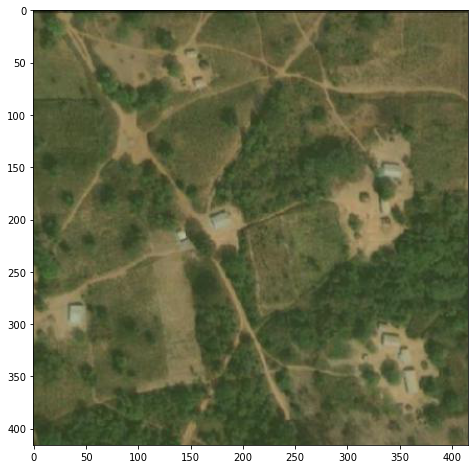

In [1314]:
display(image_random)

In [865]:
#hls = cv2.cvtColor(image_random,cv2.COLOR_BGR2HLS)
#
#for i in np.arange(36,40,1):
#    sat_q_up =(i+1)/40
#    sat_q_d =(i)/40
#    sat = 2*np.where(np.logical_and((np.quantile(hls[:,:,1],sat_q_d) < hls[:,:,1]),
#                                      (hls[:,:,1] < np.quantile(hls[:,:,1],sat_q_up))
#                                     ),255,0
#                      ).astype(np.int32)
#    print(sat_q_up,sat_q_d)
#    display((sat*0.5+cv2.cvtColor(image_random,cv2.COLOR_BGR2GRAY)*0.5).astype(np.uint32),'gray')

## GET WHAT PARAMS IS BEST

In [967]:
start = time.time()

In [ ]:
im_root_path=train_path

show_images=False

results = []

rang = 7
for i in range(rang):
    for j in range(rang):
        for z in range(rang):
            for w in range(rang):
                tps = []
                fps = []
                fns = []
                for im in images_routes:
                    df_houss = df_anot[df_anot['im_path'] == im]
                    im_path = im_root_path + im

                    image_t_det = cv2.imread(im_path)

                    im_draw,boxes,box_tp = detect_houses(image_t_det,im,df_anot,i,j,z,w)

                    image = cv2.cvtColor(image_t_det, cv2.COLOR_BGR2RGB)

                    real_b = df_houss.shape[0]

                    true_pos = len(box_tp)
                    false_pos = len(boxes)-len(box_tp)
                    false_neg = real_b-len(box_tp)
                    tps.append(true_pos)
                    fps.append(false_pos)
                    fns.append(false_neg)
                    pr, acc, f1 = compute_metrics(true_pos, false_pos, false_neg)

                    if show_images:
                        print('Running inference on: ' + im)
                        f, ax = plt.subplots(1,2,figsize=(40, 20))

                        for hous in df_houss['box'].to_list():
                            x1, y1, x2, y2 = hous[0],hous[1],hous[2],hous[3]
                            #label = str(classes[class_ids[i]])
                            label = ""
                            color = (255, 0, 0)
                            #cv2.rectangle(imagen, start point, end point, color, grosor de la línea)
                            cv2.rectangle(image, (x1, y1), (x2, y2), color, 1)


                        plt.axis('off')
                        ax[0].imshow(im_draw)
                        ax[1].imshow(image)
                        ax[0].axis('off')
                        ax[1].axis('off')

                        ax[0].set_title('RETINANET BUILDINGS {}'.format(len(boxes)))
                        ax[1].set_title('REAL BUILDINGS {}'.format(real_b))


                        title= 'TP {}, FP {}\n FN {}, TN {}\n precis = {}%, acc = {}%'
                        plt.suptitle(title.format(true_pos,false_pos,false_neg,None,round(100*pr,2),round(acc*100,2)),fontsize=25)

                        plt.show()
                
                
                #print(i,j,z,w)
                #print('TP {}, FP {} FN {}'.format(sum(tps),sum(fps),sum(fns)))
                pr, acc, f1 = compute_metrics(sum(tps),sum(fps),sum(fns))
                #print('precis = {}%, acc = {}%, f1 = {}%'.format(round(100*pr,2),round(acc*100,2),round(f1*100,2)))
                
                results.append(
                    {'i':i,
                     'j':j,
                     'z':z,
                     'w':w,
                     'tps':sum(tps),
                     'fps':sum(fps),
                     'fns':sum(fns),
                     'pr':pr,
                     'acc':acc,
                     'f1':f1
                    }
                )
                print(i,j,z,w)

In [971]:
end = time.time()

In [976]:
'process lasted {} horas'.format(round((end-start)/3600,2))

'process lasted 13.08 horas'

In [977]:
df_results = pd.DataFrame(results)

In [978]:
df_results.head()

,i,j,z,w,tps,fps,fns,pr,acc,f1
0,0,0,0,0,0,0,15329,0.000000,0.000000,0.000000
1,0,0,0,1,5253,28467,10076,0.155783,0.342684,0.214194
2,0,0,0,2,5253,28467,10076,0.155783,0.342684,0.214194
3,0,0,0,3,5253,28467,10076,0.155783,0.342684,0.214194
4,0,0,0,4,5253,28467,10076,0.155783,0.342684,0.214194


In [979]:
df_results[df_results['f1']==df_results['f1'].max()]

,i,j,z,w,tps,fps,fns,pr,acc,f1
235,0,4,5,4,8630,21164,6699,0.289656,0.562985,0.38251


In [980]:
df_results[df_results['pr'] == df_results['pr'].max()]

,i,j,z,w,tps,fps,fns,pr,acc,f1
235,0,4,5,4,8630,21164,6699,0.289656,0.562985,0.38251


In [981]:
df_results[df_results['acc'] == df_results['acc'].max()]

,i,j,z,w,tps,fps,fns,pr,acc,f1
1262,3,4,5,2,8947,31914,6382,0.218962,0.583665,0.318455


In [982]:
df_results[df_results['tps'] == df_results['tps'].max()]

,i,j,z,w,tps,fps,fns,pr,acc,f1
1262,3,4,5,2,8947,31914,6382,0.218962,0.583665,0.318455


In [983]:
df_results[df_results['fns'] == df_results['fns'].min()]

,i,j,z,w,tps,fps,fns,pr,acc,f1
1262,3,4,5,2,8947,31914,6382,0.218962,0.583665,0.318455


### CHECK SOME GOOD DETECTIONS

In [1252]:
vill = '1sT62XQgZFO-43Ixs4vvHeVr4dJKVVITz_8_png.rf.f75e252652e06e769ea62ed8bec412eb.jpg'

In [1253]:
good_detection.append(vill)

In [1250]:
good_detection

['1R226VU55ww5iO0hP2rUW0UC1AEXPtrGK_7_png.rf.139774874a6171af98a3145ce727818c.jpg',
 '1LTZhpFij3OtgDYps3fHDMxbokFk9--yG_6_png.rf.455d9739abd757889b37837ed503d18e.jpg',
 '1FZ6n-TFcBIpXSOSMey8vIgKe2CEYafSk_2_png.rf.74e0e74063f34790832221d2269ca023.jpg',
 '1IKxADxsOpd4y6yF5XPs1VVI13w4EH8Uu_8_png.rf.57be54b7e5ec9b662cc63ecb65dcbeeb.jpg',
 '1kpEW8kttexiV6sfRuKs8SroGEiFQf5T1_2_png.rf.e96837a2ee146fd6e6f3d36f7012b5cd.jpg',
 '1IKxADxsOpd4y6yF5XPs1VVI13w4EH8Uu_4_png.rf.f189c884cc2dfd3b13bfe55510de890a.jpg',
 '1DSneo4A8uBgd9QQJF-npDiLdjBHpfrpT_6_png.rf.2aac481602f3915d44d722481d70f141.jpg',
 '1Ctd2BTS32d8xSXKAXOOltmwItgUIUlHQ_7_png.rf.87844c33c7200ad4d5e9f7d3c4ed897f.jpg',
 '3_JPG.rf.285a65e864c2e1e9ac71de80b7ad29f9.jpg',
 '17_JPG.rf.e817cc606bffb7bdd1691ac7650cffa1.jpg',
 '1ValpERwhZ9IBbHp9iWc8BD4VWVgm0TxQ_7_png.rf.69b07e5f8aa81cdd92958953d0f92580.jpg',
 '1IKxADxsOpd4y6yF5XPs1VVI13w4EH8Uu_9_png.rf.0e78ae825200f96e4a84f4ef2c258c39.jpg',
 '1LTZhpFij3OtgDYps3fHDMxbokFk9--yG_8_png.rf.249eed84738d0d

In [1155]:
good_detection=[
'1R226VU55ww5iO0hP2rUW0UC1AEXPtrGK_7_png.rf.139774874a6171af98a3145ce727818c.jpg',
 '1LTZhpFij3OtgDYps3fHDMxbokFk9--yG_6_png.rf.455d9739abd757889b37837ed503d18e.jpg',
 '1FZ6n-TFcBIpXSOSMey8vIgKe2CEYafSk_2_png.rf.74e0e74063f34790832221d2269ca023.jpg',
 '1IKxADxsOpd4y6yF5XPs1VVI13w4EH8Uu_8_png.rf.57be54b7e5ec9b662cc63ecb65dcbeeb.jpg',
 '1kpEW8kttexiV6sfRuKs8SroGEiFQf5T1_2_png.rf.e96837a2ee146fd6e6f3d36f7012b5cd.jpg',
 '1IKxADxsOpd4y6yF5XPs1VVI13w4EH8Uu_4_png.rf.f189c884cc2dfd3b13bfe55510de890a.jpg',
 '1DSneo4A8uBgd9QQJF-npDiLdjBHpfrpT_6_png.rf.2aac481602f3915d44d722481d70f141.jpg',
 '1Ctd2BTS32d8xSXKAXOOltmwItgUIUlHQ_7_png.rf.87844c33c7200ad4d5e9f7d3c4ed897f.jpg',
  '3_JPG.rf.285a65e864c2e1e9ac71de80b7ad29f9.jpg',
    '17_JPG.rf.e817cc606bffb7bdd1691ac7650cffa1.jpg',
 '1ValpERwhZ9IBbHp9iWc8BD4VWVgm0TxQ_7_png.rf.69b07e5f8aa81cdd92958953d0f92580.jpg']

In [1170]:
great_detection = []

In [1179]:
great_detection.append(vill)

In [1180]:
great_detection

['1IKxADxsOpd4y6yF5XPs1VVI13w4EH8Uu_9_png.rf.0e78ae825200f96e4a84f4ef2c258c39.jpg',
 '1LTZhpFij3OtgDYps3fHDMxbokFk9--yG_8_png.rf.249eed84738d0d2d18e5e327bc1b3b21.jpg']

146.0
(array([  0, 765], dtype=int32), array([160177,  12879]))
1 3 2 3
TP 3, FP 1 FN 10
precis = 75.0%, acc = 23.08%, f1 = 35.29%


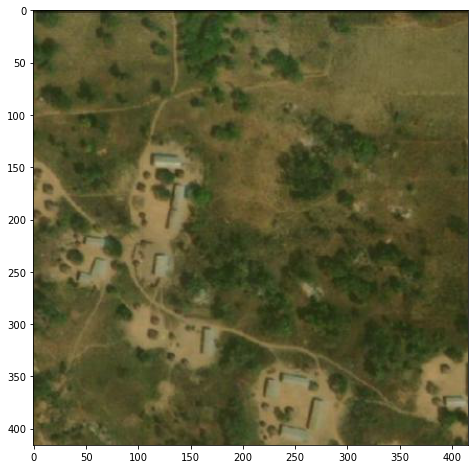

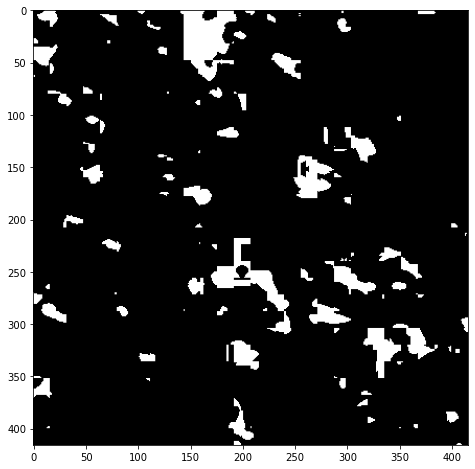

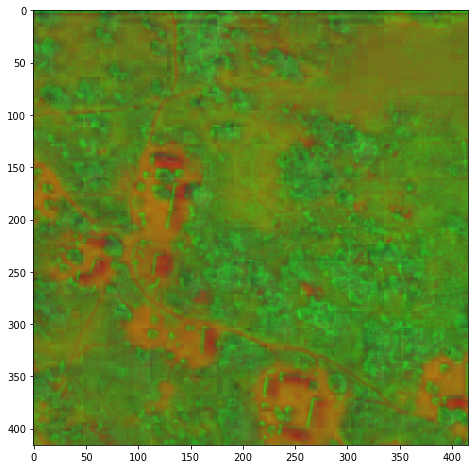

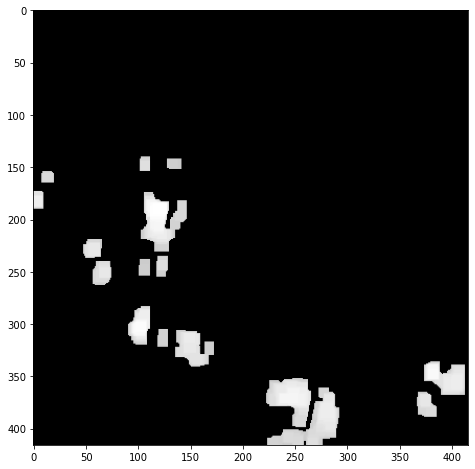

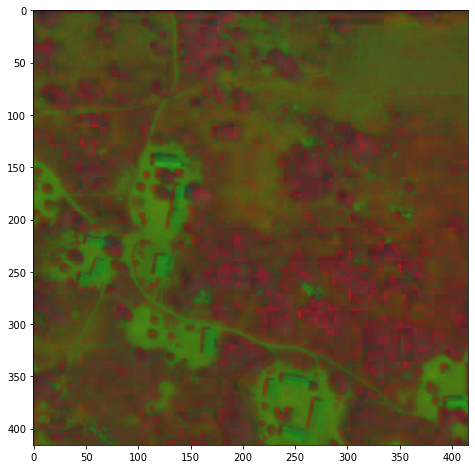

...

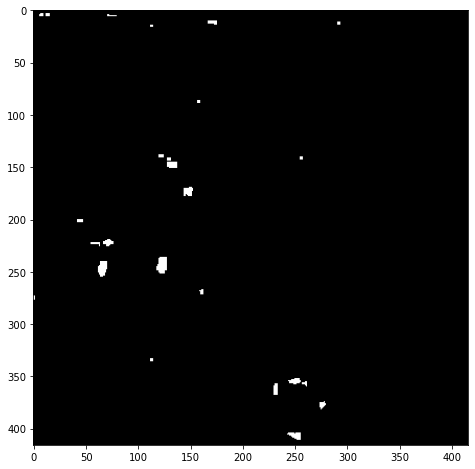

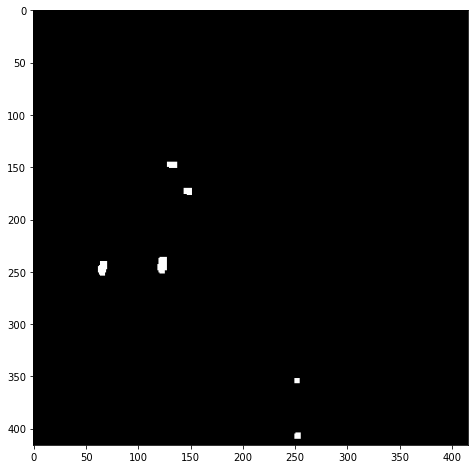

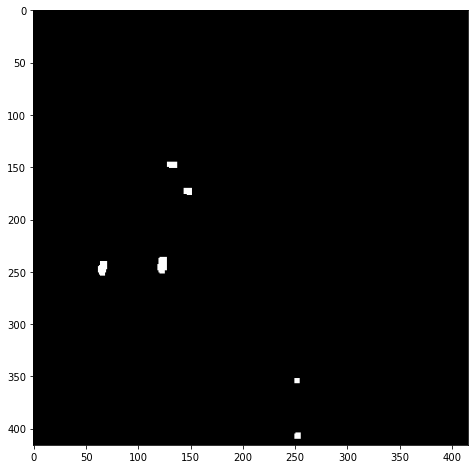

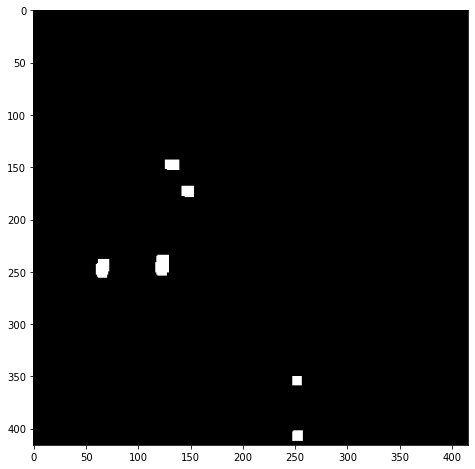

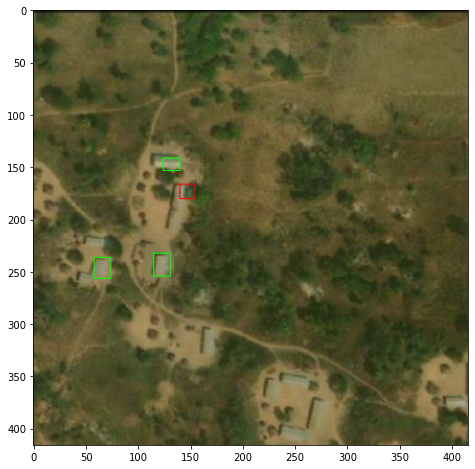

In [1265]:
i,j,z,w = 1,3,2,3
g_i=4
g_i=4
train=True
if train:
    r_p = train_path
    df_an = df_anot
else:
    r_p = test_path
    df_an = df_anot_test
    
image_g_det = cv2.imread(r_p+good_detection[g_i])
display(image_g_det)
im_draw,boxes,box_tp = detect_houses(image_g_det,good_detection[g_i],df_anot,i,j,z,w,True)
display(im_draw)

df_houss = df_an[df_an['im_path'] == good_detection[g_i]]


real_b = df_houss.shape[0]

true_pos = len(box_tp)
false_pos = len(boxes)-len(box_tp)
false_neg = real_b-len(box_tp)
pr, acc, f1 = compute_metrics(true_pos, false_pos, false_neg)

print(i,j,z,w)
print('TP {}, FP {} FN {}'.format(true_pos,false_pos,false_neg))
print('precis = {}%, acc = {}%, f1 = {}%'.format(round(100*pr,2),round(acc*100,2),round(f1*100,2)))

146.0
Running inference on: 1kpEW8kttexiV6sfRuKs8SroGEiFQf5T1_2_png.rf.e96837a2ee146fd6e6f3d36f7012b5cd.jpg
1 3 2 3


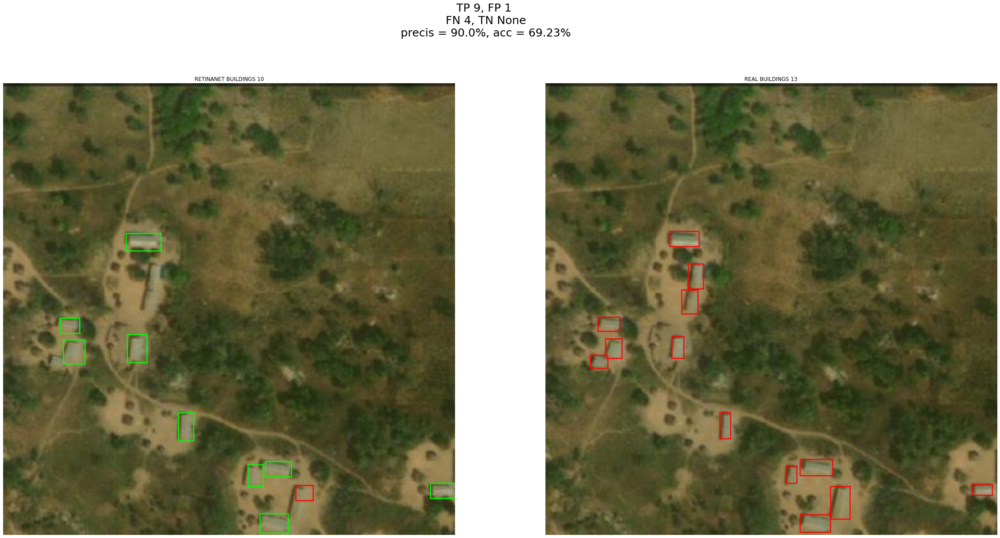

In [1259]:
im =good_detection[g_i]
df_houss = df_an[df_an['im_path'] == im]
im_path = r_p + im

image_t_det = cv2.imread(im_path)

im_draw,boxes,box_tp = detect_houses(image_t_det,im,df_an,i,j,z,w)
im_draw = cv2.cvtColor(im_draw, cv2.COLOR_BGR2RGB)

image = cv2.cvtColor(image_t_det, cv2.COLOR_BGR2RGB)

real_b = df_houss.shape[0]

true_pos = len(box_tp)
false_pos = len(boxes)-len(box_tp)
false_neg = real_b-len(box_tp)
tps.append(true_pos)
fps.append(false_pos)
fns.append(false_neg)
pr, acc, f1 = compute_metrics(true_pos, false_pos, false_neg)

if show_images:
    print('Running inference on: ' + im)
    print(i,j,z,w)
    f, ax = plt.subplots(1,2,figsize=(40, 20))

    for hous in df_houss['box'].to_list():
        x1, y1, x2, y2 = hous[0],hous[1],hous[2],hous[3]
        #label = str(classes[class_ids[i]])
        label = ""
        color = (255, 0, 0)
        #cv2.rectangle(imagen, start point, end point, color, grosor de la línea)
        cv2.rectangle(image, (x1, y1), (x2, y2), color, 1)


    plt.axis('off')
    ax[0].imshow(im_draw)
    ax[1].imshow(image)
    ax[0].axis('off')
    ax[1].axis('off')

    ax[0].set_title('RETINANET BUILDINGS {}'.format(len(boxes)))
    ax[1].set_title('REAL BUILDINGS {}'.format(real_b))


    title= 'TP {}, FP {}\n FN {}, TN {}\n precis = {}%, acc = {}%'
    plt.suptitle(title.format(true_pos,false_pos,false_neg,None,round(100*pr,2),round(acc*100,2)),fontsize=25)

    plt.show()

### ON TEST DATA

In [1227]:
test_path = '/Users/daniel/OAN/SID/dataset/test/'
df_anot_test = pd.read_csv(test_path+'_annotations.csv',header=None)
df_anot_test.columns = ['im_path','l','t','r','b','type']

df_anot_test['box'] = df_anot_test.apply(lambda x: (x['l'],x['t'],x['r'],x['b']),axis=1)

In [1228]:
images_test = [jpg for jpg in os.listdir(test_path) 
               if 'jpg' in jpg]

In [1229]:
images_test = [img for img in images_test if img.split('_')[0] in maxar_images]

In [1230]:
len(images_test)

10

In [ ]:
tps = []
fps = []
fns = []
im_root_path = test_path

show_images = True


i,j,z,w = 1,3,2,3
for im in images_test:
    df_houss = df_anot_test[df_anot_test['im_path'] == im]
    im_path = im_root_path + im

    image_t_det = cv2.imread(im_path)

    im_draw,boxes,box_tp = detect_houses(image_t_det,im,df_anot_test,i,j,z,w)
    im_draw = cv2.cvtColor(im_draw, cv2.COLOR_BGR2RGB)
    
    image = cv2.cvtColor(image_t_det, cv2.COLOR_BGR2RGB)

    real_b = df_houss.shape[0]

    true_pos = len(box_tp)
    false_pos = len(boxes)-len(box_tp)
    false_neg = real_b-len(box_tp)
    tps.append(true_pos)
    fps.append(false_pos)
    fns.append(false_neg)
    pr, acc, f1 = compute_metrics(true_pos, false_pos, false_neg)

    if show_images:
        print('Running inference on: ' + im)
        print(i,j,z,w)
        f, ax = plt.subplots(1,2,figsize=(40, 20))

        for hous in df_houss['box'].to_list():
            x1, y1, x2, y2 = hous[0],hous[1],hous[2],hous[3]
            #label = str(classes[class_ids[i]])
            label = ""
            color = (255, 0, 0)
            #cv2.rectangle(imagen, start point, end point, color, grosor de la línea)
            cv2.rectangle(image, (x1, y1), (x2, y2), color, 1)


        plt.axis('off')
        ax[0].imshow(im_draw)
        ax[1].imshow(image)
        ax[0].axis('off')
        ax[1].axis('off')

        ax[0].set_title('RETINANET BUILDINGS {}'.format(len(boxes)))
        ax[1].set_title('REAL BUILDINGS {}'.format(real_b))


        title= 'TP {}, FP {}\n FN {}, TN {}\n precis = {}%, acc = {}%'
        plt.suptitle(title.format(true_pos,false_pos,false_neg,None,round(100*pr,2),round(acc*100,2)),fontsize=25)

        plt.show()

In [1245]:
print(i,j,z,w)
print('TP {}, FP {} FN {}'.format(sum(tps),sum(fps),sum(fns)))
pr, acc, f1 = compute_metrics(sum(tps),sum(fps),sum(fns))
print('precis = {}%, acc = {}%, f1 = {}%'.format(round(100*pr,2),round(acc*100,2),round(f1*100,2)))

1 2 3 3
TP 90, FP 19 FN 52
precis = 82.57%, acc = 63.38%, f1 = 71.71%


In [1247]:
print(i,j,z,w)
print('TP {}, FP {} FN {}'.format(sum(tps),sum(fps),sum(fns)))
pr, acc, f1 = compute_metrics(sum(tps),sum(fps),sum(fns))
print('precis = {}%, acc = {}%, f1 = {}%'.format(round(100*pr,2),round(acc*100,2),round(f1*100,2)))

1 3 2 3
TP 90, FP 19 FN 52
precis = 82.57%, acc = 63.38%, f1 = 71.71%
